<a href="https://colab.research.google.com/github/AmonAmanyabyona/AI_systems/blob/main/data_mining_and_machine_learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Title: Aquarium Dataset for Object Detection Task**

**SETTING UP THE ENVIRONMENT**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!mkdir -p /content/Aquarium

# Extract the ZIP file into the parent folder
!unzip /content/drive/MyDrive/Aquarium2.coco.zip -d /content/Aquarium

Archive:  /content/drive/MyDrive/Aquarium2.coco.zip
 extracting: /content/Aquarium/README.dataset.txt  
 extracting: /content/Aquarium/README.roboflow.txt  
   creating: /content/Aquarium/test/
 extracting: /content/Aquarium/test/IMG_2289_jpeg_jpg.rf.fe2a7a149e7b11f2313f5a7b30386e85.jpg  
 extracting: /content/Aquarium/test/IMG_2301_jpeg_jpg.rf.2c19ae5efbd1f8611b5578125f001695.jpg  
 extracting: /content/Aquarium/test/IMG_2319_jpeg_jpg.rf.6e20bf97d17b74a8948aa48776c40454.jpg  
 extracting: /content/Aquarium/test/IMG_2347_jpeg_jpg.rf.7c71ac4b9301eb358cd4a832844dedcb.jpg  
 extracting: /content/Aquarium/test/IMG_2354_jpeg_jpg.rf.396e872c7fb0a95e911806986995ee7a.jpg  
 extracting: /content/Aquarium/test/IMG_2371_jpeg_jpg.rf.54505f60b6706da151c164188c305849.jpg  
 extracting: /content/Aquarium/test/IMG_2379_jpeg_jpg.rf.7dc3160c937072d26d4624c6c48e904d.jpg  
 extracting: /content/Aquarium/test/IMG_2380_jpeg_jpg.rf.a23809682eb1466c1136ca0f55de8fb5.jpg  
 extracting: /content/Aquarium/test/IM

In [ ]:
!unzip /content/drive/MyDrive/modified_train.zip -d /content/Aquarium/modified_train

Archive:  /content/drive/MyDrive/modified_train.zip
   creating: /content/Aquarium/modified_train/train/
   creating: /content/Aquarium/modified_train/train/cleaned_train/
  inflating: /content/Aquarium/modified_train/train/cleaned_train/IMG_2274_jpeg_jpg.rf.2f319e949748145fb22dcb52bb325a0c.jpg  
  inflating: /content/Aquarium/modified_train/train/cleaned_train/IMG_2275_jpeg_jpg.rf.66355520a49ba7fb7082052f7ca6fee0.jpg  
  inflating: /content/Aquarium/modified_train/train/cleaned_train/IMG_2276_jpeg_jpg.rf.7411b1902c81bad8cdefd2cc4eb3a97b.jpg  
  inflating: /content/Aquarium/modified_train/train/cleaned_train/IMG_2280_jpeg_jpg.rf.5abcce5be523f6507bbaf731dd671226.jpg  
  inflating: /content/Aquarium/modified_train/train/cleaned_train/IMG_2284_jpeg_jpg.rf.99de11cb5727748bd3eae3afe7b415e6.jpg  
  inflating: /content/Aquarium/modified_train/train/cleaned_train/IMG_2287_jpeg_jpg.rf.cce12b7bb4e49aa145398504aef84c99.jpg  
  inflating: /content/Aquarium/modified_train/train/cleaned_train/IMG_22

In [ ]:
!unzip /content/drive/MyDrive/yolo_dataset.zip -d /content/Dataset

Archive:  /content/drive/MyDrive/yolo_dataset.zip
   creating: /content/Dataset/yolo_dataset/
  inflating: /content/Dataset/yolo_dataset/data.yaml  
   creating: /content/Dataset/yolo_dataset/test/
   creating: /content/Dataset/yolo_dataset/test/images/
  inflating: /content/Dataset/yolo_dataset/test/images/IMG_2289_jpeg_jpg.rf.fe2a7a149e7b11f2313f5a7b30386e85.jpg  
  inflating: /content/Dataset/yolo_dataset/test/images/IMG_2301_jpeg_jpg.rf.2c19ae5efbd1f8611b5578125f001695.jpg  
  inflating: /content/Dataset/yolo_dataset/test/images/IMG_2319_jpeg_jpg.rf.6e20bf97d17b74a8948aa48776c40454.jpg  
  inflating: /content/Dataset/yolo_dataset/test/images/IMG_2347_jpeg_jpg.rf.7c71ac4b9301eb358cd4a832844dedcb.jpg  
  inflating: /content/Dataset/yolo_dataset/test/images/IMG_2354_jpeg_jpg.rf.396e872c7fb0a95e911806986995ee7a.jpg  
  inflating: /content/Dataset/yolo_dataset/test/images/IMG_2371_jpeg_jpg.rf.54505f60b6706da151c164188c305849.jpg  
  inflating: /content/Dataset/yolo_dataset/test/images/I

In [ ]:
%cd /content/Aquarium

/content/Aquarium


In [ ]:
!ls

Aquarium  Dataset  drive  sample_data  test11.jpg  test1.jpg  yolov8m.pt


In [ ]:
!pip install tensorflow

In [ ]:
!pip install tf_slim

In [ ]:
!pip install pycocotools


In [ ]:
!pip install albumentations


In [ ]:
!pip install opencv-python


In [ ]:
import tensorflow as tf
from tensorflow.keras import datasets, layers, models
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os
import json
from pycocotools.coco import COCO

**FEW NOTES**


This dataset can be used for tasks like coral reef conservation, environmental health monitoring

**DATA UNDERSTANDING**

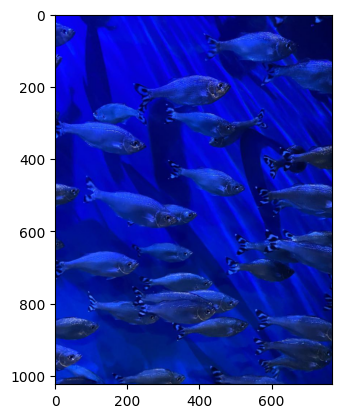

In [ ]:

import matplotlib.pyplot as plt
from PIL import Image

#the path to any image path
image_path = '/content/Aquarium/train/IMG_2274_jpeg_jpg.rf.2f319e949748145fb22dcb52bb325a0c.jpg'

# Load the image
image = Image.open(image_path)

# Display the image
plt.imshow(image)
#plt.axis('off')  # Hide the axis
plt.show()

The image size is: (768, 1024) and the mode is: RGB


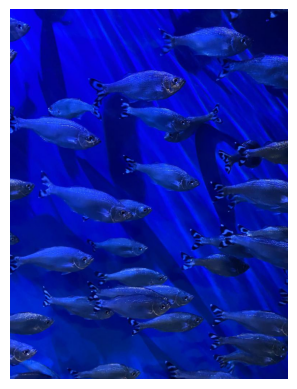

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

# the path to an image
image_path = '/content/Aquarium/train/IMG_2274_jpeg_jpg.rf.2f319e949748145fb22dcb52bb325a0c.jpg'

# Load the image
image = Image.open(image_path)

# Get the size and mode of the image
image_size = image.size
image_mode = image.mode

# Print the shape of the image
print(f"The image size is: {image_size} and the mode is: {image_mode}")

# Display the image
plt.imshow(image)
plt.axis('off')  # Hide the axis
plt.show()

In [ ]:
import json
from pycocotools.coco import COCO

# Paths to the image and annotation files
image_path = "/content/Aquarium/train/IMG_2274_jpeg_jpg.rf.2f319e949748145fb22dcb52bb325a0c.jpg"
annotation_path = "/content/Aquarium/train/_annotations.coco.json"

# Load the COCO annotations
coco = COCO(annotation_path)

# Get the image ID from the file name
image_id = None
for img in coco.dataset['images']:
    if img['file_name'] == image_path.split('/')[-1]:
        image_id = img['id']
        break

if image_id is None:
    print("Image not found in annotations.")
else:
    # Get the annotations for the image
    annotation_ids = coco.getAnnIds(imgIds=[image_id])
    annotations = coco.loadAnns(annotation_ids)

    # Extract and print the labels
    labels = [coco.loadCats(ann['category_id'])[0]['name'] for ann in annotations]
    print(f"Labels for image {image_path}: {labels}")

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
Labels for image /content/Aquarium/train/IMG_2274_jpeg_jpg.rf.2f319e949748145fb22dcb52bb325a0c.jpg: ['fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish']


In [ ]:

import json
from pycocotools.coco import COCO

# Path to the annotation file
annotation_path = "/content/Aquarium/train/_annotations.coco.json"

# Load the COCO annotations
coco = COCO(annotation_path)

# Dictionary to store labels for each image
image_labels = {}

# Loop through all images in the dataset
for img in coco.dataset['images']:
    image_id = img['id']
    image_path = img['file_name']

    # Get the annotations for the image
    annotation_ids = coco.getAnnIds(imgIds=[image_id])
    annotations = coco.loadAnns(annotation_ids)

    # Extract labels
    labels = [coco.loadCats(ann['category_id'])[0]['name'] for ann in annotations]
    image_labels[image_path] = labels

# Print labels for each image
for image_path, labels in image_labels.items():
    print(f"Labels for image {image_path}: {labels}")

loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
Labels for image IMG_2489_jpeg_jpg.rf.ffb357957a29cdef43f3fdfb2a13c417.jpg: ['jellyfish', 'jellyfish', 'jellyfish', 'jellyfish', 'jellyfish', 'jellyfish']
Labels for image IMG_8406_jpg.rf.fda4b68f345bda8047e7f15060f70e45.jpg: ['shark', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish']
Labels for image IMG_3147_jpeg_jpg.rf.fc4622004ff72e58b546635774372fe2.jpg: ['puffin', 'puffin', 'puffin']
Labels for image IMG_2402_jpeg_jpg.rf.ff2e5af0a2d1693c155a01d7494fc8e4.jpg: ['fish', 'fish', 'fish', 'fish', 'fish', 'fish']
Labels for image IMG_2584_jpeg_jpg.rf.fdf498ef5b1b000a6c51d15dc29ad33a.jpg: ['stingray', 'stingray', 'stingray', 'shark', 'stingray', 'shark', 'shark', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'shark']
Labels for image IMG_2383_jpeg_jpg.rf.fd376436d382e985e3c0e6936860212f.jpg: ['starfish', 'starfish']
Labels for image IMG_3131_jpeg_jpg.rf.fcf0c

In [ ]:

import json
from pycocotools.coco import COCO

# Path to the annotation file
annotation_path = "/content/Aquarium/train/_annotations.coco.json"

# Load the COCO annotations
coco = COCO(annotation_path)

# Dictionary to store labels for each image
image_labels = {}

# Loop through all images in the dataset
for img in coco.dataset['images']:
    image_id = img['id']
    image_path = img['file_name']

    # Get the annotations for the image
    annotation_ids = coco.getAnnIds(imgIds=[image_id])
    annotations = coco.loadAnns(annotation_ids)

    # Extract labels
    labels = [coco.loadCats(ann['category_id'])[0]['name'] for ann in annotations]
    image_labels[image_path] = labels

# Print labels for each image
for image_path, labels in image_labels.items():
    print(f"Labels for image {image_path}: {labels}")

# Print category IDs and their names
print("\nCategory IDs and their names:")
for category in coco.dataset['categories']:
    print(f"ID: {category['id']}, Name: {category['name']}")


loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
Labels for image IMG_2489_jpeg_jpg.rf.ffb357957a29cdef43f3fdfb2a13c417.jpg: ['jellyfish', 'jellyfish', 'jellyfish', 'jellyfish', 'jellyfish', 'jellyfish']
Labels for image IMG_8406_jpg.rf.fda4b68f345bda8047e7f15060f70e45.jpg: ['shark', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish']
Labels for image IMG_3147_jpeg_jpg.rf.fc4622004ff72e58b546635774372fe2.jpg: ['puffin', 'puffin', 'puffin']
Labels for image IMG_2402_jpeg_jpg.rf.ff2e5af0a2d1693c155a01d7494fc8e4.jpg: ['fish', 'fish', 'fish', 'fish', 'fish', 'fish']
Labels for image IMG_2584_jpeg_jpg.rf.fdf498ef5b1b000a6c51d15dc29ad33a.jpg: ['stingray', 'stingray', 'stingray', 'shark', 'stingray', 'shark', 'shark', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'fish', 'shark']
Labels for image IMG_2383_jpeg_jpg.rf.fd376436d382e985e3c0e6936860212f.jpg: ['starfish', 'starfish']
Labels for image IMG_3131_jpeg_jpg.rf.fcf0c

The image size is: (768, 1024) and the mode is: RGB


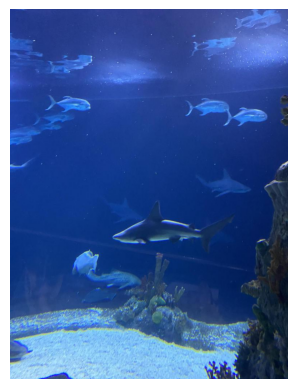

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

# Choose any path to an actual image
image_path = '/content/Aquarium/train/IMG_2558_jpeg_jpg.rf.f98546f54e44d64d7284e1116d7ca99d.jpg'

# Load the image
image = Image.open(image_path)

# Get the size and mode of the image
image_size = image.size
image_mode = image.mode

# Print the shape of the image
print(f"The image size is: {image_size} and the mode is: {image_mode}")

# Display the image
plt.imshow(image)
plt.axis('off')  # Hide the axis
plt.show()

The image size is: (768, 1024) and the mode is: RGB


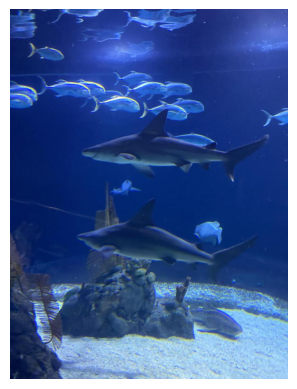

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

# Choose any path to an actual image
image_path = '/content/Aquarium/train/IMG_2561_jpeg_jpg.rf.f50a9915e352436894ae2749e4df115a.jpg'

# Load the image
image = Image.open(image_path)

# Get the size and mode of the image
image_size = image.size
image_mode = image.mode

# Print the shape of the image
print(f"The image size is: {image_size} and the mode is: {image_mode}")

# Display the image
plt.imshow(image)
plt.axis('off')  # Hide the axis
plt.show()

The image size is: (768, 1024) and the mode is: RGB


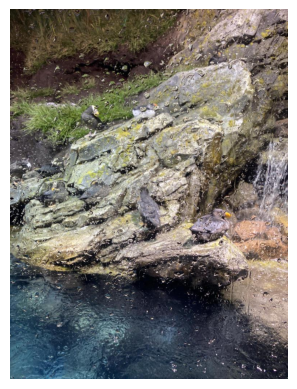

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

# the path is for an image in the train set
image_path = '/content/Aquarium/train/IMG_2283_jpeg_jpg.rf.4f28032102ddc4534410f9bf474ef1d0.jpg'

# Load the image
image = Image.open(image_path)

# Get the size and mode of the image
image_size = image.size
image_mode = image.mode

# Print the shape of the image
print(f"The image size is: {image_size} and the mode is: {image_mode}")

# Display the image
plt.imshow(image)
plt.axis('off')  # Hide the axis
plt.show()

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!


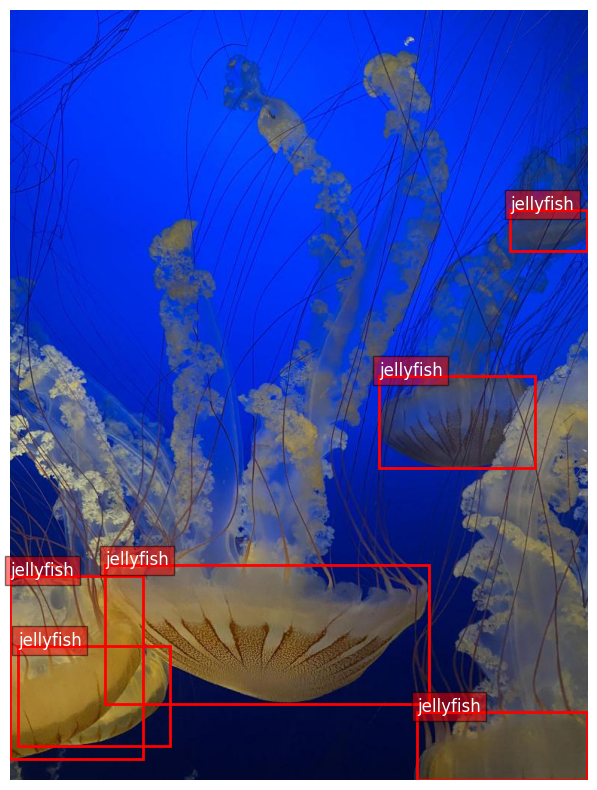

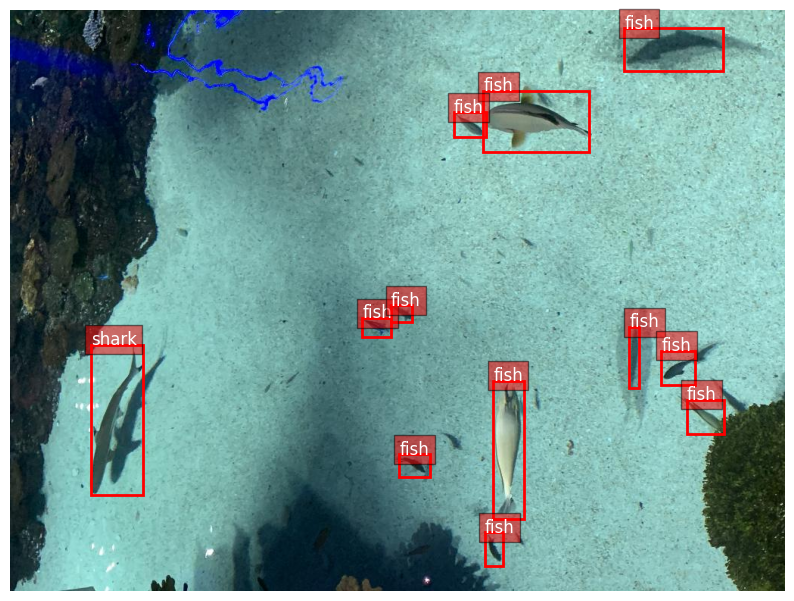

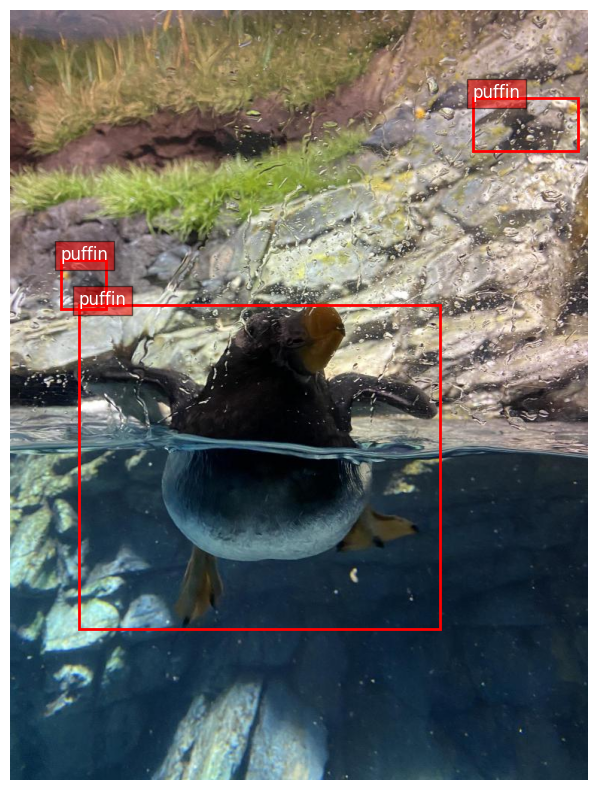

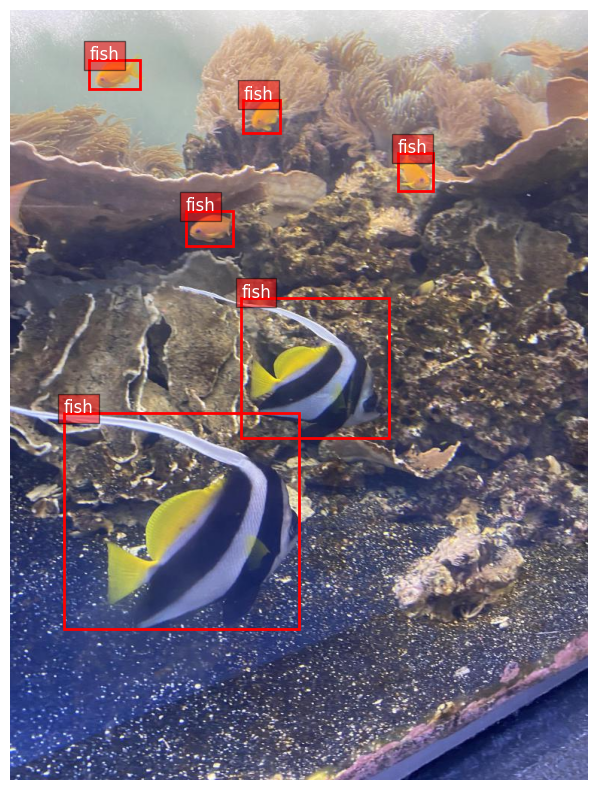

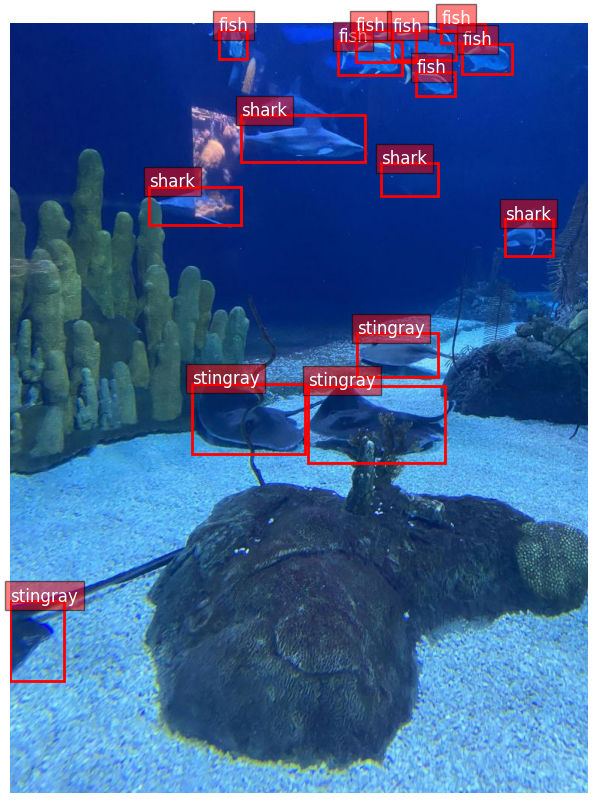

In [ ]:
import json
import os
from pycocotools.coco import COCO
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

# Path to the annotation file
annotation_path = "/content/Aquarium/train/_annotations.coco.json"

# Load the COCO annotations
coco = COCO(annotation_path)

# Function to visualize annotations
def visualize_annotations(image_path, annotations):
    image = Image.open(image_path)
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    ax = plt.gca()

    for ann in annotations:
        bbox = ann['bbox']
        rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
        plt.text(bbox[0], bbox[1], coco.loadCats(ann['category_id'])[0]['name'], color='white', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))

    plt.axis('off')
    plt.show()

# Loop through a few images in the dataset to visualize
for img in coco.dataset['images'][:5]:  # Change the range to visualize more images
    image_id = img['id']
    image_path = f"/content/Aquarium/train/{img['file_name']}"

    # Get the annotations for the image
    annotation_ids = coco.getAnnIds(imgIds=[image_id])
    annotations = coco.loadAnns(annotation_ids)

    # Visualize the annotations
    visualize_annotations(image_path, annotations)


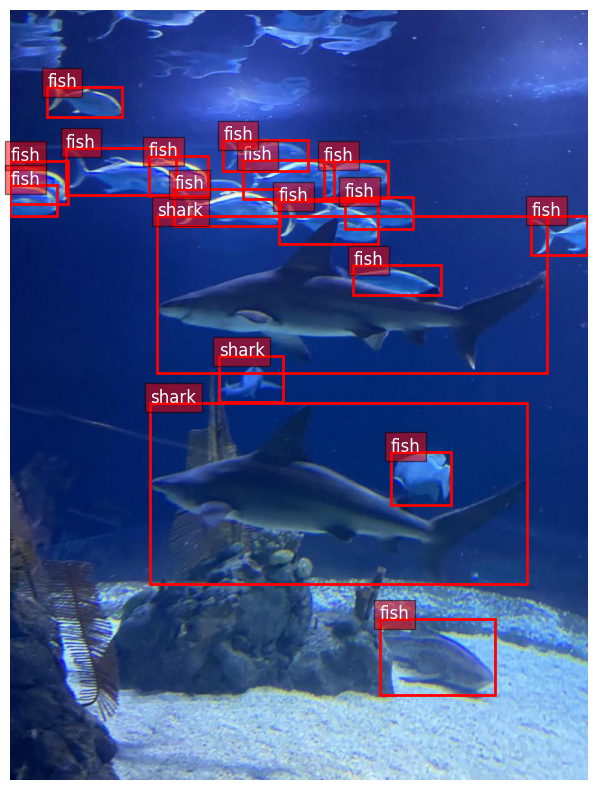

In [ ]:
# Get the last image information
last_image = coco.dataset['images'][-1]

# Construct the image path
image_path = f"/content/Aquarium/train/{last_image['file_name']}"

# Get annotations for the last image
annotation_ids = coco.getAnnIds(imgIds=[last_image['id']])
annotations = coco.loadAnns(annotation_ids)

# Visualize annotations for the last image
visualize_annotations(image_path, annotations)

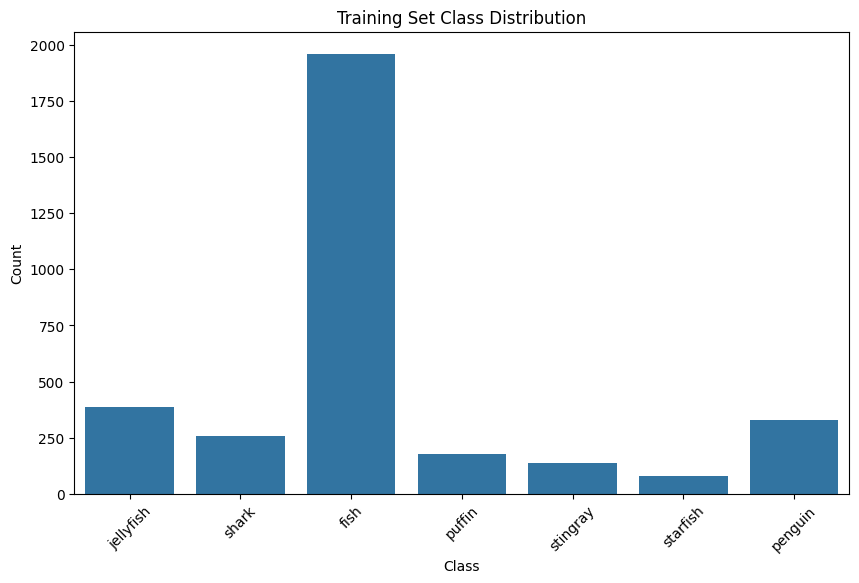

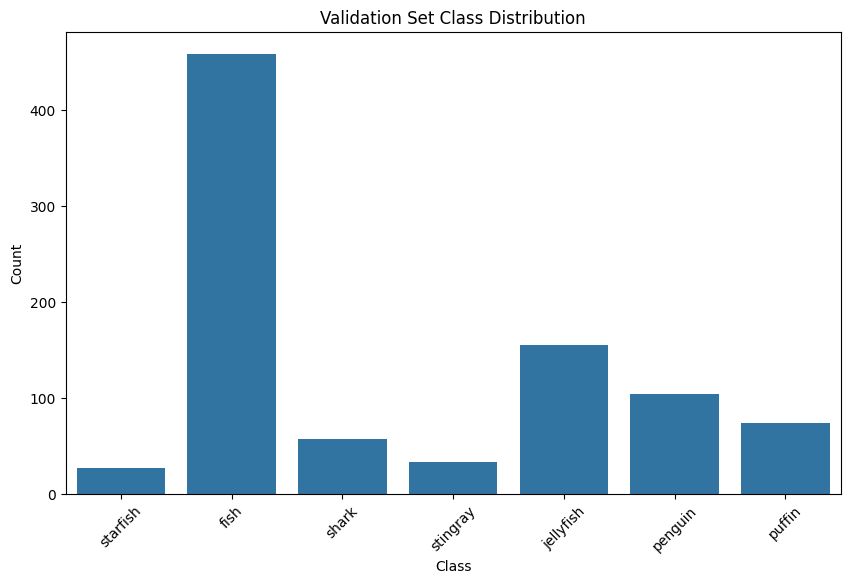

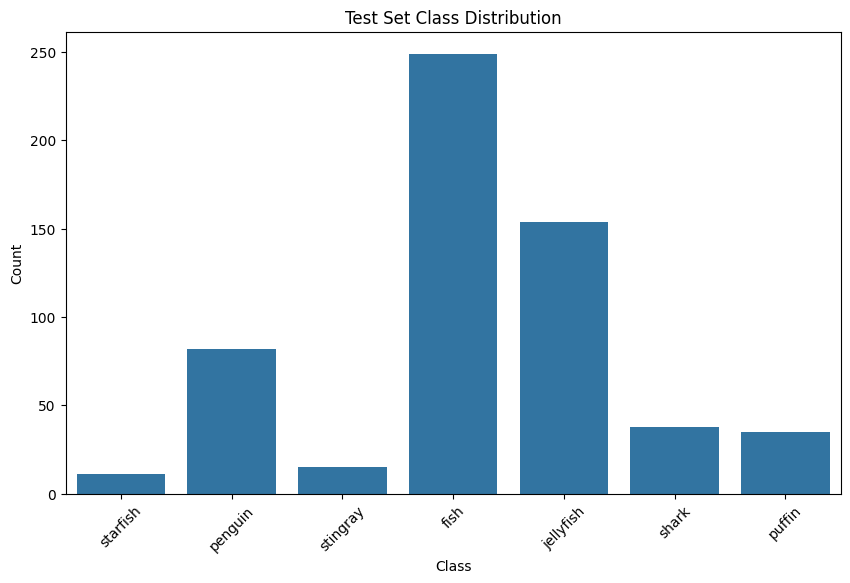

In [ ]:
import json
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import os

# Load COCO JSON file
def load_coco_json(json_path):
    with open(json_path) as f:
        data = json.load(f)
    return data

# Paths to your datasets
train_json_path = '/content/Aquarium/train/_annotations.coco.json'
valid_json_path = '/content/Aquarium/valid/_annotations.coco.json'
test_json_path = '/content/Aquarium/test/_annotations.coco.json'

# Load datasets
train_data = load_coco_json(train_json_path)
valid_data = load_coco_json(valid_json_path)
test_data = load_coco_json(test_json_path)

# Function to plot class distribution
def plot_class_distribution(data, title):
    categories = [cat['name'] for cat in data['categories']]
    annotations = data['annotations']
    class_counts = Counter([ann['category_id'] for ann in annotations])
    class_names = [categories[id] for id in class_counts.keys()]

    plt.figure(figsize=(10, 6))
    sns.barplot(x=class_names, y=list(class_counts.values()))
    plt.title(title)
    plt.xlabel('Class')
    plt.ylabel('Count')
    plt.xticks(rotation=45)
    plt.show()

# Plot class distributions
plot_class_distribution(train_data, 'Training Set Class Distribution')
plot_class_distribution(valid_data, 'Validation Set Class Distribution')
plot_class_distribution(test_data, 'Test Set Class Distribution')

In [ ]:
import json
from pycocotools.coco import COCO
from collections import defaultdict

# Path to the annotation file
annotation_path = "/content/Aquarium/train/_annotations.coco.json"

# Load the COCO annotations
coco = COCO(annotation_path)

# Dictionary to store the count of each label
label_counts = defaultdict(int)

# Get all image IDs
img_ids = coco.getImgIds()

# Iterate over image IDs
for img_id in img_ids:
    # Get annotations for the image
    ann_ids = coco.getAnnIds(imgIds=[img_id])
    annotations = coco.loadAnns(ann_ids)

    # Count labels, excluding "creatures"
    for ann in annotations:
        category_id = ann['category_id']
        #if category_id == 0:
            #continue  # Skip "creatures"
        label = coco.loadCats([category_id])[0]['name']
        label_counts[label] += 1

# Print the count of each label
print("Class balance in the dataset:")
for label, count in label_counts.items():
    print(f"{label}: {count}")

loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
Class balance in the dataset:
jellyfish: 385
shark: 259
fish: 1961
puffin: 175
stingray: 136
starfish: 78
penguin: 330


In [ ]:
# Function to count images and class instances
def count_images_and_classes(data):
    categories = {cat['id']: cat['name'] for cat in data['categories']}
    annotations = data['annotations']
    images = data['images']

    # Count total images
    total_images = len(images)

    # Count instances of each class
    class_counts = Counter([ann['category_id'] for ann in annotations])
    class_counts_named = {categories[id]: count for id, count in class_counts.items()}

    return total_images, class_counts_named

# Get counts for each dataset
train_total_images, train_class_counts = count_images_and_classes(train_data)
valid_total_images, valid_class_counts = count_images_and_classes(valid_data)
test_total_images, test_class_counts = count_images_and_classes(test_data)

# Print results
print("Training Set:")
print(f"Total Images: {train_total_images}")
print("Class Counts:", train_class_counts)

print("\nValidation Set:")
print(f"Total Images: {valid_total_images}")
print("Class Counts:", valid_class_counts)

print("\nTest Set:")
print(f"Total Images: {test_total_images}")
print("Class Counts:", test_class_counts)


Training Set:
Total Images: 448
Class Counts: {'jellyfish': 385, 'shark': 259, 'fish': 1961, 'puffin': 175, 'stingray': 136, 'starfish': 78, 'penguin': 330}

Validation Set:
Total Images: 127
Class Counts: {'starfish': 27, 'fish': 459, 'shark': 57, 'stingray': 33, 'jellyfish': 155, 'penguin': 104, 'puffin': 74}

Test Set:
Total Images: 63
Class Counts: {'starfish': 11, 'penguin': 82, 'stingray': 15, 'fish': 249, 'jellyfish': 154, 'shark': 38, 'puffin': 35}


**DATA CLEANING**

In [ ]:
import json

with open('/content/Aquarium/modified_train/train/cleaned_train/_annotations.coco.json') as f:
    annotations = json.load(f)


1.Get the list of existing image filenames:



In [ ]:
import os

image_folder = '/content/Aquarium/modified_train/train/cleaned_train'
existing_images = set(os.listdir(image_folder))

2.Filter the annotations

In [ ]:
new_annotations = {
    'images': [],
    'annotations': [],
    'categories': annotations['categories']
}

image_id_map = {}
new_image_id = 1

for image in annotations['images']:
    image_filename = image['file_name']
    if image_filename in existing_images:
        image_id_map[image['id']] = new_image_id
        image['id'] = new_image_id
        new_annotations['images'].append(image)
        new_image_id += 1

for annotation in annotations['annotations']:
    if annotation['image_id'] in image_id_map:
        annotation['image_id'] = image_id_map[annotation['image_id']]
        new_annotations['annotations'].append(annotation)

**Note**
This code essentially filters images based on their filenames, remaps their IDs, and updates the corresponding annotations to reflect these new IDs. This is useful for ensuring that the annotations are consistent with a specific subset of images.

3.Save the new annotations

In [ ]:
with open('/content/Aquarium/modified_train/train/cleaned_train/new_annotations.coco.json', 'w') as f:
    json.dump(new_annotations, f)

In [ ]:
import json
from pycocotools.coco import COCO
from collections import defaultdict

# Path to the annotation file
annotation_path = "/content/Aquarium/modified_train/train/cleaned_train/new_annotations.coco.json"

# Load the COCO annotations
coco = COCO(annotation_path)

# Dictionary to store the count of each label
label_counts = defaultdict(int)

# Get all image IDs
img_ids = coco.getImgIds()

# Iterate over image IDs
for img_id in img_ids:
    # Get annotations for the image
    ann_ids = coco.getAnnIds(imgIds=[img_id])
    annotations = coco.loadAnns(ann_ids)

    # Count labels, excluding "creatures" because it is a superclass for all of them
    for ann in annotations:
        category_id = ann['category_id']
        if category_id == 0:
            continue
        label = coco.loadCats([category_id])[0]['name']
        label_counts[label] += 1

# Print the count of each label
print("Class balance in the dataset:")
for label, count in label_counts.items():
    print(f"{label}: {count}")

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
Class balance in the dataset:
jellyfish: 292
puffin: 50
fish: 1021
stingray: 94
shark: 141
starfish: 52
penguin: 122


**Previously the classes were like**:
jellyfish: 385
shark: 259
fish: 1961
puffin: 175
stingray: 136
starfish: 78
penguin: 330

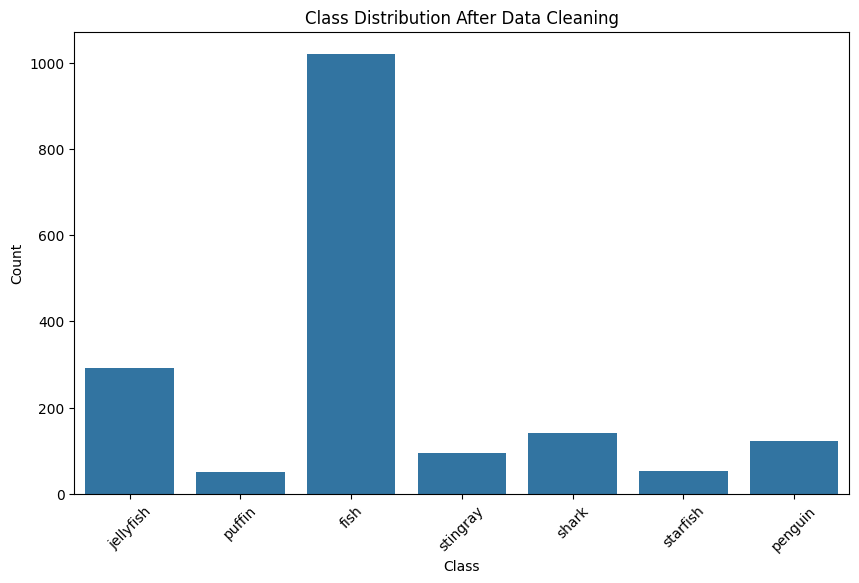

In [ ]:
import json
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import os

# Plot the class distribution
labels = list(label_counts.keys())
counts = list(label_counts.values())

plt.figure(figsize=(10, 6))
sns.barplot(x=labels, y=counts)
plt.title('Class Distribution After Data Cleaning')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import json
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import os

# Load COCO JSON file for the cleaned train set
def load_clean_coco_json(json_path):
    with open(json_path) as f:
        clean_data = json.load(f)
    return clean_data

# Paths to your datasets
clean_train_json_path = '/content/Aquarium/modified_train/train/cleaned_train/new_annotations.coco.json'


# Load datasets
clean_train_data = load_clean_coco_json(clean_train_json_path)


# Function to count images and class instances
def count_images_and_classes_for_clean_train_set(clean_data):
    categories = {cat['id']: cat['name'] for cat in clean_data['categories']}
    annotations = clean_data['annotations']
    images = clean_data['images']

    # Count total images
    total_images = len(images)

    # Count instances of each class
    class_counts = Counter([ann['category_id'] for ann in annotations])
    class_counts_named = {categories[id]: count for id, count in class_counts.items()}

    return total_images, class_counts_named

# Get counts for each dataset
train_total_images, train_class_counts = count_images_and_classes_for_clean_train_set(clean_train_data)


# Print results
print("Cleaned Train Set:")
print(f"Total Images: {train_total_images}")
print("Class Counts:", train_class_counts)

Cleaned Train Set:
Total Images: 259
Class Counts: {'jellyfish': 292, 'puffin': 50, 'fish': 1021, 'stingray': 94, 'shark': 141, 'starfish': 52, 'penguin': 122}


**Note**
Below we focus on the training set to avoid any bias or leakage into validation and test sets

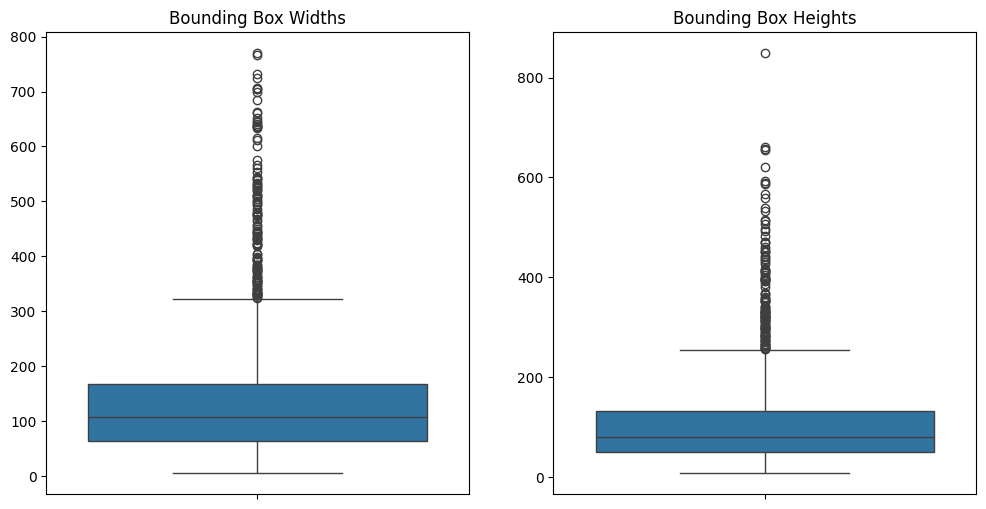

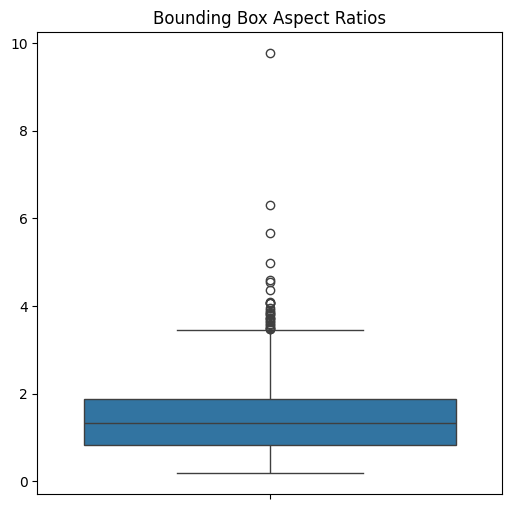

In [ ]:
import numpy as np

# Function to extract bounding box sizes and aspect ratios
def extract_bbox_info(clean_data):
    annotations = clean_data['annotations']
    bbox_widths = [ann['bbox'][2] for ann in annotations]
    bbox_heights = [ann['bbox'][3] for ann in annotations]
    aspect_ratios = [w / h for w, h in zip(bbox_widths, bbox_heights)]
    bbox_centers_x = [ann['bbox'][0] + ann['bbox'][2] / 2 for ann in annotations]
    bbox_centers_y = [ann['bbox'][1] + ann['bbox'][3] / 2 for ann in annotations]

    return bbox_widths, bbox_heights, aspect_ratios, bbox_centers_x, bbox_centers_y

# Extract information for training set
train_bbox_widths, train_bbox_heights, train_aspect_ratios, train_centers_x, train_centers_y = extract_bbox_info(clean_train_data)

# Boxplot for bounding box sizes
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.boxplot(data=train_bbox_widths)
plt.title('Bounding Box Widths')
plt.subplot(1, 2, 2)
sns.boxplot(data=train_bbox_heights)
plt.title('Bounding Box Heights')
plt.show()

# Boxplot for aspect ratios
plt.figure(figsize=(6, 6))
sns.boxplot(data=train_aspect_ratios)
plt.title('Bounding Box Aspect Ratios')
plt.show()



We generate a scatterplot to visualize the relationship between the bounding box widths and heights for the training data (train_bbox_widths and train_bbox_heights).

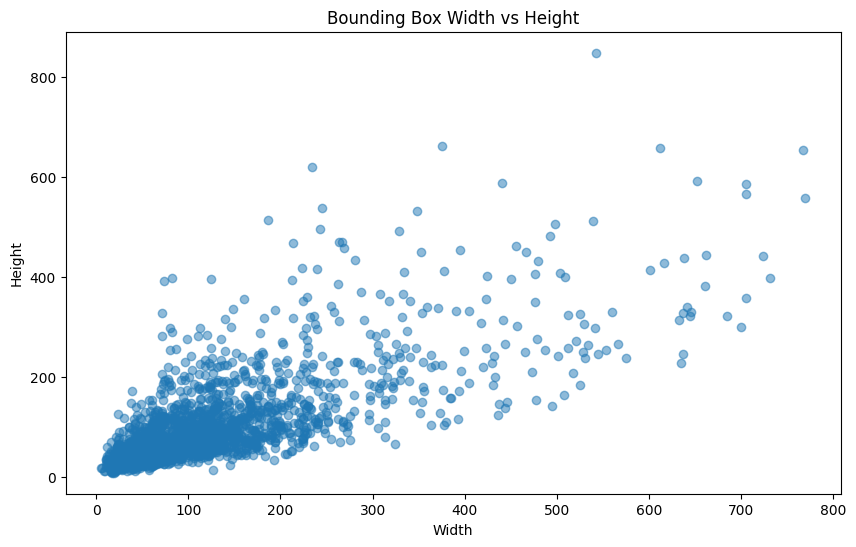

In [ ]:
# Scatterplot for bounding box sizes
plt.figure(figsize=(10, 6))
plt.scatter(train_bbox_widths, train_bbox_heights, alpha=0.5)
plt.title('Bounding Box Width vs Height')
plt.xlabel('Width')
plt.ylabel('Height')
plt.show()

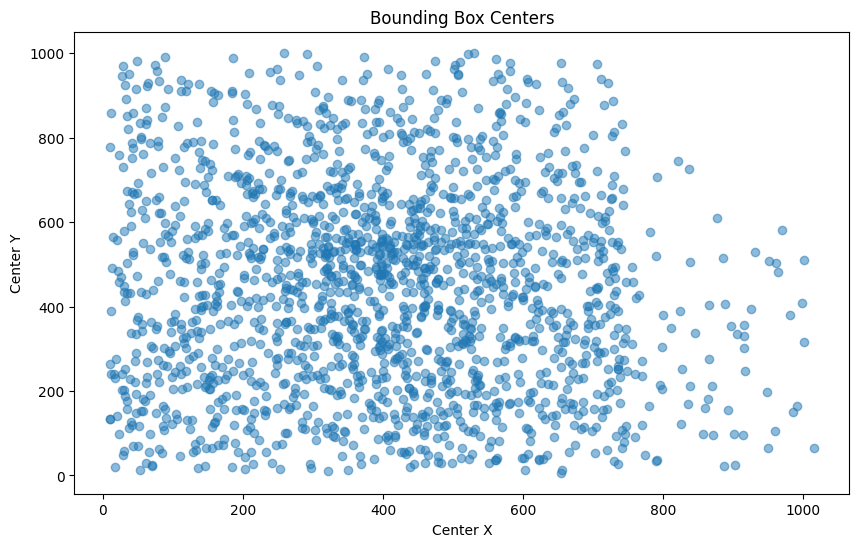

In [ ]:
# Scatterplot for bounding box locations
plt.figure(figsize=(10, 6))
plt.scatter(train_centers_x, train_centers_y, alpha=0.5)
plt.title('Bounding Box Centers')
plt.xlabel('Center X')
plt.ylabel('Center Y')
plt.show()

**Class IDS**

In [ ]:
from pycocotools.coco import COCO

# Load COCO annotations
coco = COCO('/content/Aquarium/modified_train/train/cleaned_train/new_annotations.coco.json')
# Extract class IDs
class_ids = set()
for ann in coco.anns.values():
    class_ids.add(ann['category_id'])

# Print class IDs
print("Class IDs in the training set:")
print(class_ids)

loading annotations into memory...
Done (t=0.32s)
creating index...
index created!
Class IDs in the training set:
{1, 2, 3, 4, 5, 6, 7}


In [ ]:
from pycocotools.coco import COCO

# Load COCO annotations
coco = COCO('/content/Aquarium/modified_train/train/cleaned_train/new_annotations.coco.json')

# Extract class IDs and names
class_ids = []
class_names = []
for ann in coco.anns.values():
    class_ids.append(ann['category_id'])
    class_names.append(coco.loadCats([ann['category_id']])[0]['name'])

# Create a dictionary mapping class names to IDs
class_name_to_id = dict(zip(class_names, class_ids))

# Print class IDs and names
print("Class names and their corresponding IDs:")
for class_name, class_id in class_name_to_id.items():
    print(f"{class_name}: {class_id}")

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
Class names and their corresponding IDs:
jellyfish: 2
puffin: 4
fish: 1
stingray: 7
shark: 5
starfish: 6
penguin: 3


Class balance in the cleaned dataset:
jellyfish: 292
puffin: 50
fish: 1021
stingray: 94
shark: 141
starfish: 52
penguin: 122

**DATA AUGMENTATION**

In [ ]:
import cv2
import numpy as np
from pycocotools.coco import COCO
from PIL import Image
import matplotlib.pyplot as plt

Load COCO Annotations


In [ ]:
# Path to the annotation file
annotation_path = "/content/Aquarium/modified_train/train/cleaned_train/new_annotations.coco.json"

# Load the COCO annotations
coco = COCO(annotation_path)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


 Define Minority Class IDs


In [ ]:
# Define minority class IDs based on your previous output
minority_class_ids = [4, 6, 7]  # Example: [puffin, starfish, stingray]

Identify Images with Minority Classes


In [ ]:
# Dictionary to store image IDs and their minority class counts
image_minority_counts = {}

# Get all image IDs
img_ids = coco.getImgIds()

# Iterate over image IDs
for img_id in img_ids:
    # Get annotations for the image
    ann_ids = coco.getAnnIds(imgIds=[img_id])
    annotations = coco.loadAnns(ann_ids)

    # Count minority class instances
    minority_count = sum(1 for ann in annotations if ann['category_id'] in minority_class_ids)

    if minority_count > 0:
        image_minority_counts[img_id] = minority_count

# Sort images by the number of minority class instances
sorted_images = sorted(image_minority_counts.items(), key=lambda x: x[1], reverse=True)

# Print sorted image IDs and their minority class counts
for img_id, count in sorted_images:
    print(f"Image ID: {img_id}, Minority Class Count: {count}")

Image ID: 232, Minority Class Count: 8
Image ID: 106, Minority Class Count: 7
Image ID: 149, Minority Class Count: 7
Image ID: 246, Minority Class Count: 7
Image ID: 195, Minority Class Count: 6
Image ID: 137, Minority Class Count: 5
Image ID: 139, Minority Class Count: 5
Image ID: 235, Minority Class Count: 5
Image ID: 4, Minority Class Count: 4
Image ID: 102, Minority Class Count: 4
Image ID: 258, Minority Class Count: 4
Image ID: 2, Minority Class Count: 3
Image ID: 8, Minority Class Count: 3
Image ID: 53, Minority Class Count: 3
Image ID: 74, Minority Class Count: 3
Image ID: 140, Minority Class Count: 3
Image ID: 170, Minority Class Count: 3
Image ID: 204, Minority Class Count: 3
Image ID: 225, Minority Class Count: 3
Image ID: 236, Minority Class Count: 3
Image ID: 5, Minority Class Count: 2
Image ID: 11, Minority Class Count: 2
Image ID: 20, Minority Class Count: 2
Image ID: 21, Minority Class Count: 2
Image ID: 23, Minority Class Count: 2
Image ID: 27, Minority Class Count: 2
I

Visualize Identified Images


Visualizing Image ID: 232, Minority Class Count: 8


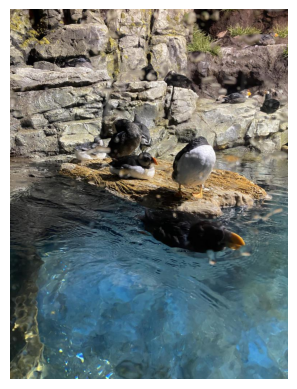

Visualizing Image ID: 106, Minority Class Count: 7


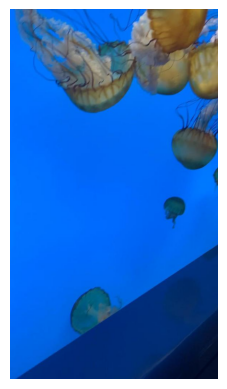

Visualizing Image ID: 149, Minority Class Count: 7


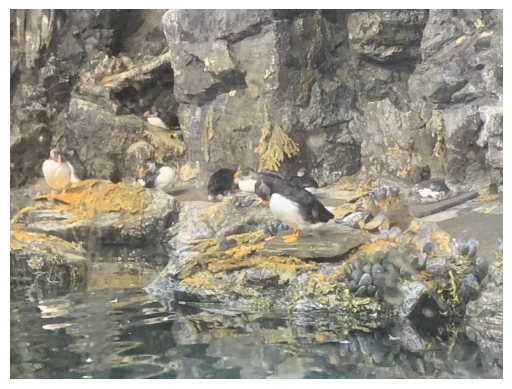

Visualizing Image ID: 246, Minority Class Count: 7


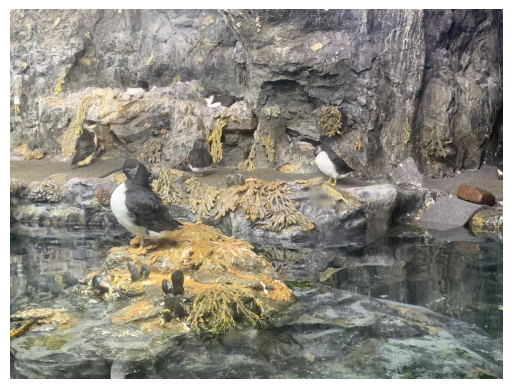

Visualizing Image ID: 195, Minority Class Count: 6


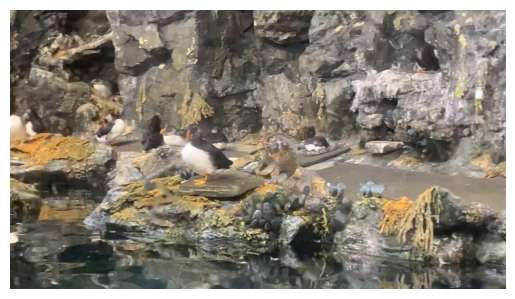

In [ ]:
# Function to visualize an image
def visualize_image(image_path):
    # Load the image
    image = Image.open(image_path)

    # Display the image
    plt.imshow(image)
    plt.axis('off')  # Hide the axis
    plt.show()

# Visualize top N images with the most minority class instances
top_n = 5  # Number of images to visualize
for img_id, count in sorted_images[:top_n]:
    img_info = coco.loadImgs([img_id])[0]
    image_path = f"/content/Aquarium/modified_train/train/cleaned_train/{img_info['file_name']}"
    print(f"Visualizing Image ID: {img_id}, Minority Class Count: {count}")
    visualize_image(image_path)

Identify Images with Minority Classes and Their Specific Counts


In [ ]:
# Dictionary to store image IDs and their minority class counts
image_minority_counts = {}

# Get all image IDs
img_ids = coco.getImgIds()

# Iterate over image IDs
for img_id in img_ids:
    # Get annotations for the image
    ann_ids = coco.getAnnIds(imgIds=[img_id])
    annotations = coco.loadAnns(ann_ids)

    # Dictionary to store counts of each minority class in the image
    minority_class_counts = {class_id: 0 for class_id in minority_class_ids}

    # Count minority class instances
    for ann in annotations:
        if ann['category_id'] in minority_class_ids:
            minority_class_counts[ann['category_id']] += 1

    # Filter out images with no minority class instances
    if any(count > 0 for count in minority_class_counts.values()):
        image_minority_counts[img_id] = minority_class_counts

# Print sorted image IDs and their minority class counts
for img_id, counts in image_minority_counts.items():
    print(f"Image ID: {img_id}, Minority Class Counts: {counts}")

Image ID: 2, Minority Class Counts: {4: 3, 6: 0, 7: 0}
Image ID: 4, Minority Class Counts: {4: 0, 6: 0, 7: 4}
Image ID: 5, Minority Class Counts: {4: 0, 6: 2, 7: 0}
Image ID: 6, Minority Class Counts: {4: 0, 6: 1, 7: 0}
Image ID: 8, Minority Class Counts: {4: 0, 6: 0, 7: 3}
Image ID: 11, Minority Class Counts: {4: 0, 6: 0, 7: 2}
Image ID: 13, Minority Class Counts: {4: 0, 6: 0, 7: 1}
Image ID: 16, Minority Class Counts: {4: 1, 6: 0, 7: 0}
Image ID: 19, Minority Class Counts: {4: 0, 6: 0, 7: 1}
Image ID: 20, Minority Class Counts: {4: 0, 6: 2, 7: 0}
Image ID: 21, Minority Class Counts: {4: 0, 6: 0, 7: 2}
Image ID: 22, Minority Class Counts: {4: 1, 6: 0, 7: 0}
Image ID: 23, Minority Class Counts: {4: 0, 6: 0, 7: 2}
Image ID: 24, Minority Class Counts: {4: 0, 6: 1, 7: 0}
Image ID: 27, Minority Class Counts: {4: 0, 6: 0, 7: 2}
Image ID: 28, Minority Class Counts: {4: 0, 6: 0, 7: 1}
Image ID: 29, Minority Class Counts: {4: 0, 6: 0, 7: 1}
Image ID: 36, Minority Class Counts: {4: 0, 6: 0, 7: 

 Map Class IDs to Class Names


In [ ]:
# Define a mapping from class IDs to class names
class_id_to_name = {
    4: 'puffin',
    6: 'starfish',
    7: 'stingray'
}

# Print sorted image IDs and their minority class counts with names
for img_id, counts in image_minority_counts.items():
    named_counts = {class_id_to_name[class_id]: count for class_id, count in counts.items() if count > 0}
    print(f"Image ID: {img_id}, Minority Class Counts: {named_counts}")

Image ID: 2, Minority Class Counts: {'puffin': 3}
Image ID: 4, Minority Class Counts: {'stingray': 4}
Image ID: 5, Minority Class Counts: {'starfish': 2}
Image ID: 6, Minority Class Counts: {'starfish': 1}
Image ID: 8, Minority Class Counts: {'stingray': 3}
Image ID: 11, Minority Class Counts: {'stingray': 2}
Image ID: 13, Minority Class Counts: {'stingray': 1}
Image ID: 16, Minority Class Counts: {'puffin': 1}
Image ID: 19, Minority Class Counts: {'stingray': 1}
Image ID: 20, Minority Class Counts: {'starfish': 2}
Image ID: 21, Minority Class Counts: {'stingray': 2}
Image ID: 22, Minority Class Counts: {'puffin': 1}
Image ID: 23, Minority Class Counts: {'stingray': 2}
Image ID: 24, Minority Class Counts: {'starfish': 1}
Image ID: 27, Minority Class Counts: {'stingray': 2}
Image ID: 28, Minority Class Counts: {'stingray': 1}
Image ID: 29, Minority Class Counts: {'stingray': 1}
Image ID: 36, Minority Class Counts: {'stingray': 1}
Image ID: 37, Minority Class Counts: {'stingray': 2}
Imag

Separate and Sort Images by Minority Class


In [ ]:
# Initialize dictionaries to store image IDs and their counts for each class
puffin_images = {}
starfish_images = {}
stingray_images = {}

# Populate the dictionaries
for img_id, counts in image_minority_counts.items():
    for class_id, count in counts.items():
        if class_id == 4:  # Puffin
            puffin_images[img_id] = count
        elif class_id == 6:  # Starfish
            starfish_images[img_id] = count
        elif class_id == 7:  # Stingray
            stingray_images[img_id] = count

# Sort the dictionaries by count in descending order
sorted_puffin_images = sorted(puffin_images.items(), key=lambda x: x[1], reverse=True)
sorted_starfish_images = sorted(starfish_images.items(), key=lambda x: x[1], reverse=True)
sorted_stingray_images = sorted(stingray_images.items(), key=lambda x: x[1], reverse=True)

# Print the sorted lists
print("Puffin Images:")
for img_id, count in sorted_puffin_images:
    print(f"Image ID: {img_id}, Puffin Count: {count}")

print("\nStarfish Images:")
for img_id, count in sorted_starfish_images:
    print(f"Image ID: {img_id}, Starfish Count: {count}")

print("\nStingray Images:")
for img_id, count in sorted_stingray_images:
    print(f"Image ID: {img_id}, Stingray Count: {count}")

Puffin Images:
Image ID: 232, Puffin Count: 8
Image ID: 149, Puffin Count: 7
Image ID: 246, Puffin Count: 7
Image ID: 195, Puffin Count: 6
Image ID: 102, Puffin Count: 4
Image ID: 2, Puffin Count: 3
Image ID: 170, Puffin Count: 3
Image ID: 225, Puffin Count: 3
Image ID: 16, Puffin Count: 1
Image ID: 22, Puffin Count: 1
Image ID: 66, Puffin Count: 1
Image ID: 86, Puffin Count: 1
Image ID: 87, Puffin Count: 1
Image ID: 146, Puffin Count: 1
Image ID: 154, Puffin Count: 1
Image ID: 217, Puffin Count: 1
Image ID: 241, Puffin Count: 1
Image ID: 4, Puffin Count: 0
Image ID: 5, Puffin Count: 0
Image ID: 6, Puffin Count: 0
Image ID: 8, Puffin Count: 0
Image ID: 11, Puffin Count: 0
Image ID: 13, Puffin Count: 0
Image ID: 19, Puffin Count: 0
Image ID: 20, Puffin Count: 0
Image ID: 21, Puffin Count: 0
Image ID: 23, Puffin Count: 0
Image ID: 24, Puffin Count: 0
Image ID: 27, Puffin Count: 0
Image ID: 28, Puffin Count: 0
Image ID: 29, Puffin Count: 0
Image ID: 36, Puffin Count: 0
Image ID: 37, Puffi

Create Directories for Each Minority Class


In [ ]:
import os
import shutil
from pycocotools.coco import COCO
import json

# Define the base path
base_path = "/content/Aquarium"

# Define minority class names
minority_classes = ['puffin', 'starfish', 'stingray']

# Create directories for each minority class
for class_name in minority_classes:
    class_path = os.path.join(base_path, class_name)
    os.makedirs(class_path, exist_ok=True)

Filter and Copy Images to Respective Directories


In [ ]:
# Function to copy images to respective directories
def copy_images(sorted_images, class_name):
    for img_id, count in sorted_images:
        if count > 1:  # Only copy images with more than 1 instance
            # Get image info
            img_info = coco.loadImgs([img_id])[0]
            image_path = f"/content/Aquarium/modified_train/train/cleaned_train/{img_info['file_name']}"

            # Define destination path
            dest_path = os.path.join(base_path, class_name, img_info['file_name'])

            # Copy image
            shutil.copy(image_path, dest_path)

# Copy images for each minority class
copy_images(sorted_puffin_images, 'puffin')
copy_images(sorted_starfish_images, 'starfish')
copy_images(sorted_stingray_images, 'stingray')

**see list in the folder to ensure annotations are not included on image**

Filter and Copy Annotations to Respective Directories


In [ ]:
# Function to copy annotations to respective directories
def copy_annotations(sorted_images, class_name):
    for img_id, count in sorted_images:
        if count > 1:  # Only copy annotations for images with more than 1 instance
            # Get image info
            img_info = coco.loadImgs([img_id])[0]
            image_file_name = img_info['file_name']

            # Get annotations for the image
            ann_ids = coco.getAnnIds(imgIds=[img_id])
            annotations = coco.loadAnns(ann_ids)

            # Define annotation file path using the image file name
            annotation_file_name = image_file_name.replace('.jpg', '_annotations.json').replace('.png', '_annotations.json')
            annotation_path = os.path.join(base_path, class_name, annotation_file_name)

            # Save annotations to file
            with open(annotation_path, 'w') as f:
                json.dump(annotations, f)

# Copy annotations for each minority class
copy_annotations(sorted_puffin_images, 'puffin')
copy_annotations(sorted_starfish_images, 'starfish')
copy_annotations(sorted_stingray_images, 'stingray')

Puffin

The image size is: (768, 1024) and the mode is: RGB


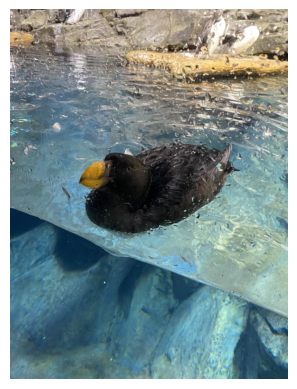

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

# Choose any path to an actual image
image_path ='/content/Aquarium/puffin/IMG_2284_jpeg_jpg.rf.99de11cb5727748bd3eae3afe7b415e6.jpg'

# Load the image
image = Image.open(image_path)

# Get the size and mode of the image
image_size = image.size
image_mode = image.mode

# Print the shape of the image
print(f"The image size is: {image_size} and the mode is: {image_mode}")

# Display the image
plt.imshow(image)
plt.axis('off')  # Hide the axis
plt.show()

In [ ]:
import cv2
import json
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
#Load Image and Annotations
# Define paths
image_path = "/content/Aquarium/puffin/IMG_8535_MOV-3_jpg.rf.5b8daac9353f088bac733681586e1450.jpg"
annotation_path = "/content/Aquarium/puffin/IMG_8535_MOV-3_jpg.rf.5b8daac9353f088bac733681586e1450_annotations.json"

# Load image
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

# Load annotations
with open(annotation_path, 'r') as f:
    annotations = json.load(f)

# Define a mapping from class IDs to class names
class_id_to_name = {
    4: 'puffin',
    6: 'starfish',
    7: 'stingray'
}


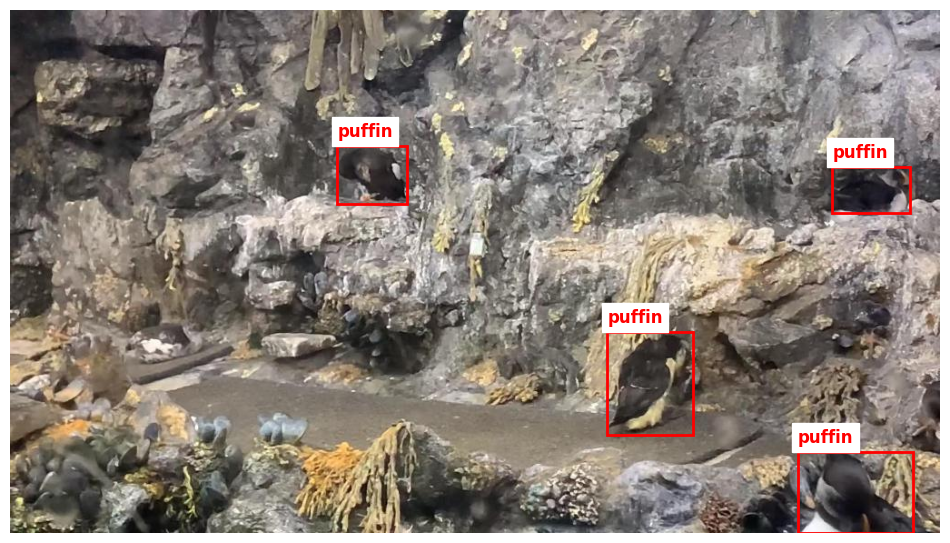

In [ ]:
#Visualize Image with Annotations and Class Names
# Function to draw bounding boxes with class names
def draw_annotations(image, annotations, class_id_to_name):
    fig, ax = plt.subplots(1, figsize=(12, 9))
    ax.imshow(image)

    for ann in annotations:
        bbox = ann['bbox']
        x, y, width, height = bbox
        class_id = ann['category_id']
        class_name = class_id_to_name.get(class_id, 'unknown')

        # Draw bounding box
        rect = Rectangle((x, y), width, height, linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

        # Draw class name
        ax.text(x, y - 10, class_name, color='red', fontsize=12, weight='bold', backgroundcolor='white')

    plt.axis('off')
    plt.show()

# Draw annotations on the image with class names
draw_annotations(image, annotations, class_id_to_name)

Starfish

The image size is: (768, 1024) and the mode is: RGB


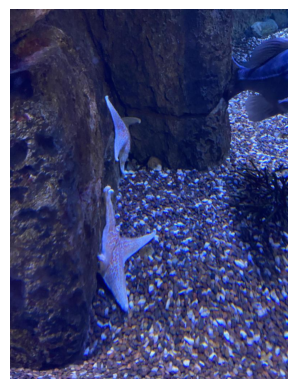

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

# Choose any path to an actual image
image_path ='/content/Aquarium/starfish/IMG_2386_jpeg_jpg.rf.24ef35f21ff0b936ede4bb3a50c0886e.jpg'

# Load the image
image = Image.open(image_path)

# Get the size and mode of the image
image_size = image.size
image_mode = image.mode

# Print the shape of the image
print(f"The image size is: {image_size} and the mode is: {image_mode}")

# Display the image
plt.imshow(image)
plt.axis('off')  # Hide the axis
plt.show()

In [ ]:
import cv2
import json
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
#Load Image and Annotations
# Define paths
image_path = "/content/Aquarium/starfish/IMG_3188_jpeg_jpg.rf.747520ca7cf3643faf40accc5db68c4d.jpg"
annotation_path = "/content/Aquarium/starfish/IMG_3188_jpeg_jpg.rf.747520ca7cf3643faf40accc5db68c4d_annotations.json"

# Load image
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

# Load annotations
with open(annotation_path, 'r') as f:
    annotations = json.load(f)

# Define a mapping from class IDs to class names
class_id_to_name = {
    4: 'puffin',
    6: 'starfish',
    7: 'stingray'
}


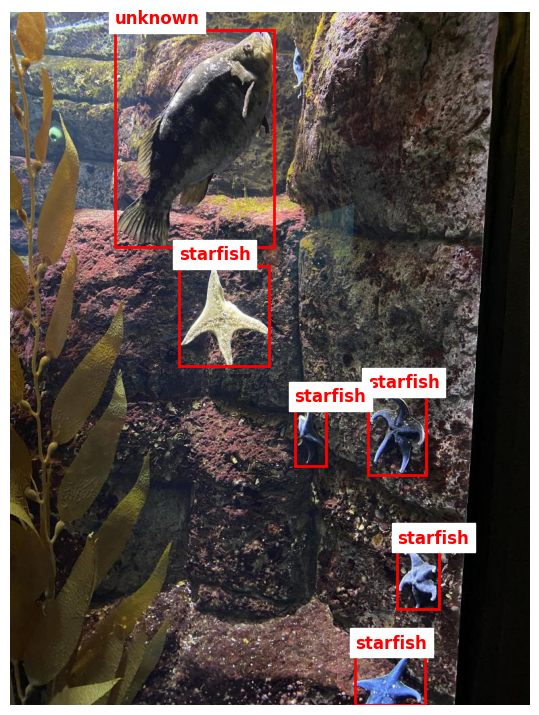

In [ ]:
#Visualize Image with Annotations and Class Names
# Function to draw bounding boxes with class names
def draw_annotations_starfish(image, annotations, class_id_to_name):
    fig, ax = plt.subplots(1, figsize=(12, 9))
    ax.imshow(image)

    for ann in annotations:
        bbox = ann['bbox']
        x, y, width, height = bbox
        class_id = ann['category_id']
        class_name = class_id_to_name.get(class_id, 'unknown')

        # Draw bounding box
        rect = Rectangle((x, y), width, height, linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

        # Draw class name
        ax.text(x, y - 10, class_name, color='red', fontsize=12, weight='bold', backgroundcolor='white')

    plt.axis('off')
    plt.show()

# Draw annotations on the image with class names
draw_annotations_starfish(image, annotations, class_id_to_name)

Stringray

The image size is: (768, 1024) and the mode is: RGB


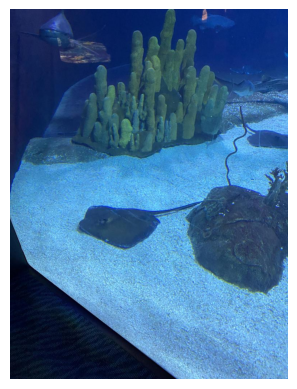

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

# Choose any path to an actual image
image_path ='/content/Aquarium/stingray/IMG_2578_jpeg_jpg.rf.63adda94658b934843ed3ab53fb52b7d.jpg'

# Load the image
image = Image.open(image_path)

# Get the size and mode of the image
image_size = image.size
image_mode = image.mode

# Print the shape of the image
print(f"The image size is: {image_size} and the mode is: {image_mode}")

# Display the image
plt.imshow(image)
plt.axis('off')  # Hide the axis
plt.show()

In [ ]:
import cv2
import json
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
#Load Image and Annotations
# Define paths
image_path = "/content/Aquarium/stingray/IMG_2578_jpeg_jpg.rf.63adda94658b934843ed3ab53fb52b7d.jpg"
annotation_path = "/content/Aquarium/stingray/IMG_2578_jpeg_jpg.rf.63adda94658b934843ed3ab53fb52b7d_annotations.json"

# Load image
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

# Load annotations
with open(annotation_path, 'r') as f:
    annotations = json.load(f)

# Define a mapping from class IDs to class names
class_id_to_name = {
    4: 'puffin',
    6: 'starfish',
    7: 'stingray'
}


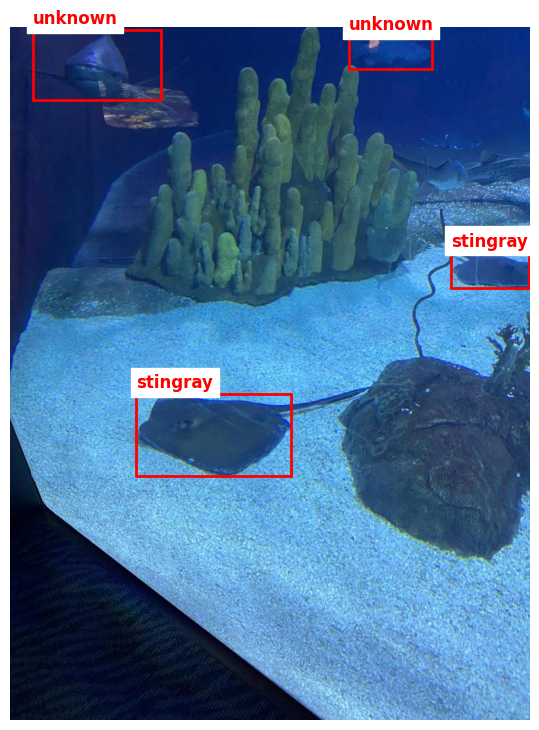

In [ ]:
#Visualize Image with Annotations and Class Names
# Function to draw bounding boxes with class names
def draw_annotations_stingray(image, annotations, class_id_to_name):
    fig, ax = plt.subplots(1, figsize=(12, 9))
    ax.imshow(image)

    for ann in annotations:
        bbox = ann['bbox']
        x, y, width, height = bbox
        class_id = ann['category_id']
        class_name = class_id_to_name.get(class_id, 'unknown')

        # Draw bounding box
        rect = Rectangle((x, y), width, height, linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

        # Draw class name
        ax.text(x, y - 10, class_name, color='red', fontsize=12, weight='bold', backgroundcolor='white')

    plt.axis('off')
    plt.show()

# Draw annotations on the image with class names
draw_annotations_stingray(image, annotations, class_id_to_name)

**HORIZONTAL FLIPPING**

In [ ]:
import cv2
import json
import os
import numpy as np
from pycocotools.coco import COCO
from PIL import Image, ImageEnhance
import shutil

def flip_image_horizontally(image):
    # Flip image horizontally
    flipped_image = cv2.flip(image, 1)
    return flipped_image

def flip_boxes_horizontally(image, annotations):
    h, w = image.shape[:2]
    flipped_annotations = []

    for ann in annotations:
        bbox = ann['bbox']
        x, y, width, height = bbox

        # Calculate new coordinates
        new_x = w - (x + width)
        new_bbox = [new_x, y, width, height]

        # Update annotation
        flipped_ann = ann.copy()
        flipped_ann['bbox'] = new_bbox
        flipped_annotations.append(flipped_ann)

    return flipped_annotations

**Note**
We have to make sure that the bounding boxes(annotations) are modified correctly as well which is done in the line of code that calculates new coordinates i.e


        new_x = w - (x + width)
        new_bbox = [new_x, y, width, height]
        
for example:

If an image has a width of 800 pixels and a bounding box with the following coordinates:
•  Original Bounding Box:

         ([x, y, \text{width}, \text{height}] = [100, 50, 200, 150])

The new x-coordinate after flipping the image horizontally would be:

                 [ x' = 800 - (100 + 200) = 800 - 300 = 500 ]

So, the new bounding box coordinates would be:


                   [ [500, 50, 200, 150] ]

 Load Images and Annotations


In [ ]:
# Define paths
base_path = "/content/Aquarium"
minority_classes = ['puffin', 'starfish', 'stingray']

# Function to load images and annotations
def load_images_and_annotations(class_name):
    class_path = os.path.join(base_path, class_name)
    images = []
    annotations = []

    for file_name in os.listdir(class_path):
        if file_name.endswith(".jpg") or file_name.endswith(".png"):
            image_path = os.path.join(class_path, file_name)
            images.append(image_path)

            # Load corresponding annotations
            annotation_file_name = file_name.replace('.jpg', '_annotations.json').replace('.png', '_annotations.json')
            annotation_path = os.path.join(class_path, annotation_file_name)

            with open(annotation_path, 'r') as f:
                anns = json.load(f)

            annotations.append((image_path, anns))

    return images, annotations

# Load images and annotations for each class
puffin_images, puffin_annotations = load_images_and_annotations('puffin')
starfish_images, starfish_annotations = load_images_and_annotations('starfish')
stingray_images, stingray_annotations = load_images_and_annotations('stingray')

Apply Data Augmentation and Update Annotations


In [ ]:
# Function to apply augmentation and update annotations
def augment_and_save(images, annotations, class_name):
    augmented_images_path = os.path.join(base_path, f"augmented_{class_name}")
    os.makedirs(augmented_images_path, exist_ok=True)

    for image_path, anns in zip(images, annotations):
        # Load image
        image = cv2.imread(image_path)

        # Apply augmentation (flip horizontally)
        augmented_image = flip_image_horizontally(image)
        augmented_annotations = flip_boxes_horizontally(image, anns[1])

        # Save augmented image
        augmented_image_name = os.path.basename(image_path).replace('.jpg', '_aug.jpg').replace('.png', '_aug.png')
        augmented_image_path = os.path.join(augmented_images_path, augmented_image_name)
        cv2.imwrite(augmented_image_path, augmented_image)

        # Save updated annotations
        augmented_annotation_name = augmented_image_name.replace('.jpg', '_annotations.json').replace('.png', '_annotations.json')
        augmented_annotation_path = os.path.join(augmented_images_path, augmented_annotation_name)

        with open(augmented_annotation_path, 'w') as f:
            json.dump(augmented_annotations, f)

# Apply augmentation and save for each class
augment_and_save(puffin_images, puffin_annotations, 'puffin')
augment_and_save(starfish_images, starfish_annotations, 'starfish')
augment_and_save(stingray_images, stingray_annotations, 'stingray')


**Visualize the augmented images for each class**

Augmented Puffin

The image size is: (768, 1024) and the mode is: RGB


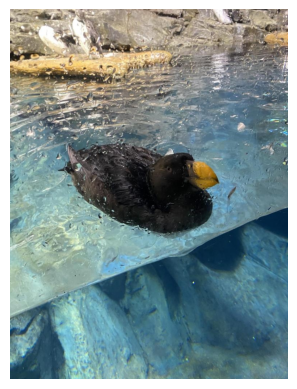

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

# Choose any path to an actual image
image_path ='/content/Aquarium/augmented_puffin/IMG_2284_jpeg_jpg.rf.99de11cb5727748bd3eae3afe7b415e6_aug.jpg'

# Load the image
image = Image.open(image_path)

# Get the size and mode of the image
image_size = image.size
image_mode = image.mode

# Print the shape of the image
print(f"The image size is: {image_size} and the mode is: {image_mode}")

# Display the image
plt.imshow(image)
plt.axis('off')  # Hide the axis
plt.show()

In [ ]:
import cv2
import json
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
#Load Image and Annotations
# Define paths
image_path = "/content/Aquarium/augmented_puffin/IMG_2284_jpeg_jpg.rf.99de11cb5727748bd3eae3afe7b415e6_aug.jpg"
annotation_path = "/content/Aquarium/augmented_puffin/IMG_2284_jpeg_jpg.rf.99de11cb5727748bd3eae3afe7b415e6_aug_annotations.json"

# Load image
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

# Load annotations
with open(annotation_path, 'r') as f:
    annotations = json.load(f)

# Define a mapping from class IDs to class names
class_id_to_name = {
    4: 'puffin',
    6: 'starfish',
    7: 'stingray'
}


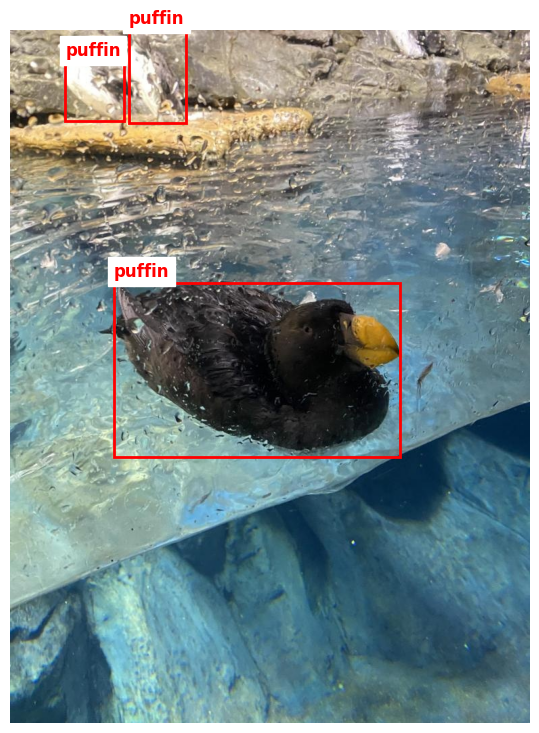

In [ ]:
#Visualize Image with Annotations and Class Names
# Function to draw bounding boxes with class names
def draw_annotations_stingray(image, annotations, class_id_to_name):
    fig, ax = plt.subplots(1, figsize=(12, 9))
    ax.imshow(image)

    for ann in annotations:
        bbox = ann['bbox']
        x, y, width, height = bbox
        class_id = ann['category_id']
        class_name = class_id_to_name.get(class_id, 'unknown')

        # Draw bounding box
        rect = Rectangle((x, y), width, height, linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

        # Draw class name
        ax.text(x, y - 10, class_name, color='red', fontsize=12, weight='bold', backgroundcolor='white')

    plt.axis('off')
    plt.show()

# Draw annotations on the image with class names
draw_annotations_stingray(image, annotations, class_id_to_name)

The image size is: (768, 1024) and the mode is: RGB


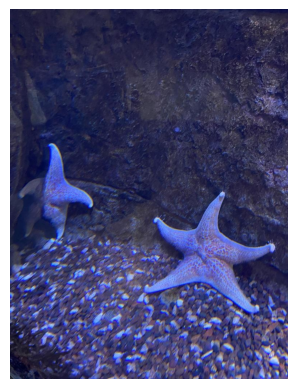

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

# Choose any path to an actual image
image_path ='/content/Aquarium/augmented_starfish/IMG_2383_jpeg_jpg.rf.fd376436d382e985e3c0e6936860212f_aug.jpg'

# Load the image
image = Image.open(image_path)

# Get the size and mode of the image
image_size = image.size
image_mode = image.mode

# Print the shape of the image
print(f"The image size is: {image_size} and the mode is: {image_mode}")

# Display the image
plt.imshow(image)
plt.axis('off')  # Hide the axis
plt.show()

Augmented_starfish

The image size is: (768, 1024) and the mode is: RGB


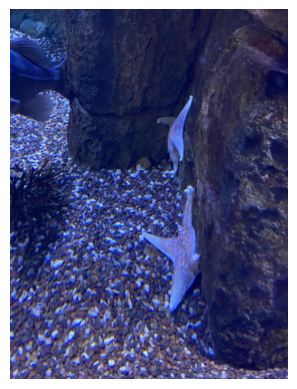

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

# Choose any path to an actual image
image_path ='/content/Aquarium/augmented_starfish/IMG_2386_jpeg_jpg.rf.24ef35f21ff0b936ede4bb3a50c0886e_aug.jpg'

# Load the image
image = Image.open(image_path)

# Get the size and mode of the image
image_size = image.size
image_mode = image.mode

# Print the shape of the image
print(f"The image size is: {image_size} and the mode is: {image_mode}")

# Display the image
plt.imshow(image)
plt.axis('off')  # Hide the axis
plt.show()

Augmented_stingray

The image size is: (768, 1024) and the mode is: RGB


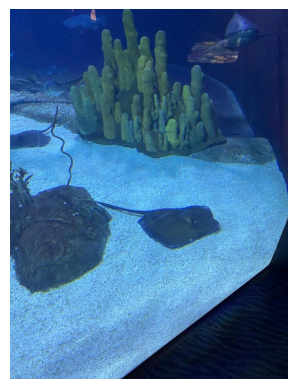

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

# Choose any path to an actual image
image_path ='/content/Aquarium/augmented_stingray/IMG_2578_jpeg_jpg.rf.63adda94658b934843ed3ab53fb52b7d_aug.jpg'

# Load the image
image = Image.open(image_path)

# Get the size and mode of the image
image_size = image.size
image_mode = image.mode

# Print the shape of the image
print(f"The image size is: {image_size} and the mode is: {image_mode}")

# Display the image
plt.imshow(image)
plt.axis('off')  # Hide the axis
plt.show()

Copy Augmented Images to the General Training Set Path


In [ ]:
import os
import shutil
import json


# Define base paths
base_path = "/content/Aquarium"
new_train_path = os.path.join(base_path, "new_train")
augmented_paths = {
    'puffin': os.path.join(base_path, "augmented_puffin"),
    'starfish': os.path.join(base_path, "augmented_starfish"),
    'stingray': os.path.join(base_path, "augmented_stingray")
}
#original_train_path = os.path.join(base_path, "train")
original_train_path = "/content/Aquarium/modified_train/train/cleaned_train"


Copy Original and Augmented Images to New Training Set Path


In [ ]:
# Create new training set directory
os.makedirs(new_train_path, exist_ok=True)

# Function to copy files to the new training set path
def copy_files_to_new_train(source_path, new_train_path):
    for file_name in os.listdir(source_path):
        source_file_path = os.path.join(source_path, file_name)
        new_train_file_path = os.path.join(new_train_path, file_name)

        # Check for naming conflicts and rename if necessary
        if os.path.exists(new_train_file_path):
            base, ext = os.path.splitext(file_name)
            new_file_name = f"{base}_aug{ext}"
            new_train_file_path = os.path.join(new_train_path, new_file_name)

        # Copy file
        shutil.copy(source_file_path, new_train_file_path)

# Copy original and augmented files
copy_files_to_new_train(original_train_path, new_train_path)
for class_name in augmented_paths.keys():
    copy_files_to_new_train(augmented_paths[class_name], new_train_path)

  Load Existing COCO Annotations


In [ ]:
# Load existing COCO annotations
annotations_path = os.path.join(original_train_path, "new_annotations.coco.json")
with open(annotations_path, 'r') as f:
    coco_annotations = json.load(f)

Merge Augmented Annotations with Existing COCO Annotations


In [ ]:
# Function to merge augmented annotations with existing COCO annotations
def merge_augmented_annotations(augmented_path, coco_annotations):
    for file_name in os.listdir(augmented_path):
        if file_name.endswith("_annotations.json"):
            augmented_annotation_path = os.path.join(augmented_path, file_name)

            # Load augmented annotations
            with open(augmented_annotation_path, 'r') as f:
                augmented_annotations = json.load(f)

            # Update image and annotation IDs to avoid conflicts
            new_image_id = max([img['id'] for img in coco_annotations['images']]) + 1
            new_annotation_id = max([ann['id'] for ann in coco_annotations['annotations']]) + 1

            # Update image info
            image_file_name = file_name.replace('_annotations.json', '.jpg').replace('_annotations.json', '.png')
            new_image_info = {
                'id': new_image_id,
                'file_name': image_file_name,
                #'width': augmented_annotations[0]['image_width'],
                #'height': augmented_annotations[0]['image_height']
            }
            coco_annotations['images'].append(new_image_info)

            # Update annotations
            for ann in augmented_annotations:
                ann['id'] = new_annotation_id
                ann['image_id'] = new_image_id
                coco_annotations['annotations'].append(ann)
                new_annotation_id += 1

# Merge augmented annotations for each class
for class_name in augmented_paths.keys():
    merge_augmented_annotations(augmented_paths[class_name], coco_annotations)

# Save the updated COCO annotations in the new training set path
new_annotations_path = os.path.join(new_train_path, "_annotations.coco.json")
with open(new_annotations_path, 'w') as f:
    json.dump(coco_annotations, f)

visualize

In [ ]:
import os
import json

# Define the path to the main annotations file
main_annotations_path = "/content/Aquarium/new_train/new_annotations.coco.json"

# Load the existing COCO annotations
with open(main_annotations_path, 'r') as f:
    coco_annotations = json.load(f)

# Function to merge a single augmented annotation file into the main COCO annotations
def merge_single_annotation(augmented_annotation_path, coco_annotations):
    # Load augmented annotations
    with open(augmented_annotation_path, 'r') as f:
        augmented_annotations = json.load(f)

    # Update image and annotation IDs to avoid conflicts
    new_image_id = max([img['id'] for img in coco_annotations['images']]) + 1
    new_annotation_id = max([ann['id'] for ann in coco_annotations['annotations']]) + 1

    # Update image info
    image_file_name = os.path.basename(augmented_annotation_path).replace('_annotations.json', '.jpg').replace('_annotations.json', '.png')
    new_image_info = {
        'id': new_image_id,
        'file_name': image_file_name,

    }
    coco_annotations['images'].append(new_image_info)

    # Update annotations
    for ann in augmented_annotations:
        ann['id'] = new_annotation_id
        ann['image_id'] = new_image_id
        coco_annotations['annotations'].append(ann)
        new_annotation_id += 1

# Iterate through all JSON files in the new_train folder and merge them
new_train_path = "/content/Aquarium/new_train"
for file_name in os.listdir(new_train_path):
    if file_name.endswith("_annotations.json") and file_name != "_annotations.coco.json":
        augmented_annotation_path = os.path.join(new_train_path, file_name)
        merge_single_annotation(augmented_annotation_path, coco_annotations)

# Save the updated COCO annotations
with open(main_annotations_path, 'w') as f:
    json.dump(coco_annotations, f)

In [ ]:
import json
import matplotlib.pyplot as plt
from collections import Counter

# Define the path to the annotations file
annotations_path = "/content/Aquarium/new_train/new_annotations.coco.json"

# Load the annotations
with open(annotations_path, 'r') as f:
    coco_annotations = json.load(f)

In [ ]:
import json
import os

# Paths
main_annotation_path = '/content/Aquarium/new_train/new_annotations.coco.json'
augmented_annotations_dir = '/content/Aquarium/new_train/'
combined_annotation_path = '/content/Aquarium/new_train/combined_annotations.coco.json'

# Load main annotations
with open(main_annotation_path, 'r') as f:
    main_annotations = json.load(f)

# Ensure the main annotations have the required keys
if 'images' not in main_annotations:
    main_annotations['images'] = []
if 'annotations' not in main_annotations:
    main_annotations['annotations'] = []
if 'categories' not in main_annotations:
    main_annotations['categories'] = []

# Function to merge annotations
def merge_annotations(main_annotations, aug_annotations):
    if isinstance(aug_annotations, list):
        main_annotations['annotations'].extend(aug_annotations)
    elif 'images' in aug_annotations and isinstance(aug_annotations['images'], list):
        main_annotations['images'].extend(aug_annotations['images'])
        main_annotations['annotations'].extend(aug_annotations['annotations'])
        main_annotations['categories'] = aug_annotations['categories']  # Assuming categories are the same

# Load and merge augmented annotations
for file_name in os.listdir(augmented_annotations_dir):
    if file_name.endswith('_aug_annotations.json'):
        print(f"Processing file: {file_name}")
        with open(os.path.join(augmented_annotations_dir, file_name), 'r') as f:
            try:
                aug_annotations = json.load(f)
                if isinstance(aug_annotations, list):
                    print(f"Augmented annotations loaded: {len(aug_annotations)} annotations")
                    merge_annotations(main_annotations, aug_annotations)
                else:
                    print(f"Error: Unexpected structure in {file_name}")
            except json.JSONDecodeError as e:
                print(f"Error decoding JSON from file {file_name}: {e}")

# Save combined annotations
with open(combined_annotation_path, 'w') as f:
    json.dump(main_annotations, f)

print(f"Combined annotations saved to {combined_annotation_path}")
print(f"Total annotations in combined file: {len(main_annotations['annotations'])}")

Processing file: IMG_2650_jpeg_jpg.rf.1afc879d751b50c9d8c935269e8995ff_aug_annotations.json
Augmented annotations loaded: 3 annotations
Processing file: IMG_2597_jpeg_jpg.rf.0f07eb126fe35d31acdbec7adb23ed50_aug_annotations.json
Augmented annotations loaded: 8 annotations
Processing file: IMG_3122_jpeg_jpg.rf.e9a29910dc8281cd1709baad92212e23_aug_annotations.json
Augmented annotations loaded: 2 annotations
Processing file: IMG_2614_jpeg_jpg.rf.3e97fad88a0f36e45bd32ecd13a34be6_aug_annotations.json
Augmented annotations loaded: 3 annotations
Processing file: IMG_2639_jpeg_jpg.rf.44073e788a70dcd9df5e84d85f16a602_aug_annotations.json
Augmented annotations loaded: 3 annotations
Processing file: IMG_2383_jpeg_jpg.rf.fd376436d382e985e3c0e6936860212f_aug_annotations.json
Augmented annotations loaded: 2 annotations
Processing file: IMG_3181_jpeg_jpg.rf.c52b54494d4236e54b900fe60bd6565b_aug_annotations.json
Augmented annotations loaded: 2 annotations
Processing file: IMG_3148_jpeg_jpg.rf.daef4a62da

Count Instances of Each Class


In [ ]:
import json
import matplotlib.pyplot as plt
from collections import Counter

# Define the path to the annotations file
annotations_path = "/content/Aquarium/new_train/combined_annotations.coco.json"

# Load the annotations
with open(annotations_path, 'r') as f:
    coco_annotations = json.load(f)

In [ ]:
# Extract category IDs from annotations
category_ids = [ann['category_id'] for ann in coco_annotations['annotations']]

# Count the instances of each class
class_counts = Counter(category_ids)

# Map category IDs to category names
category_id_to_name = {cat['id']: cat['name'] for cat in coco_annotations['categories']}
class_names = [category_id_to_name[cat_id] for cat_id in class_counts.keys()]
counts = list(class_counts.values())


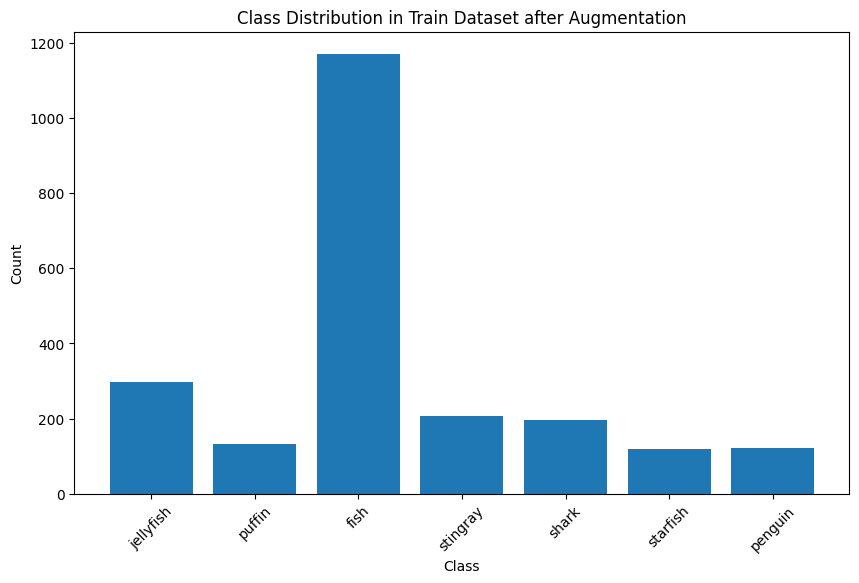

In [ ]:
# Plot the histogram
plt.figure(figsize=(10, 6))
plt.bar(class_names, counts)
plt.xlabel('Class')
plt.ylabel('Count')
plt.title('Class Distribution in Train Dataset after Augmentation')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import json
from collections import Counter

# Define the path to the annotations file
annotations_path = "/content/Aquarium/new_train/combined_annotations.coco.json"

# Load the annotations
with open(annotations_path, 'r') as f:
    coco_annotations = json.load(f)

# Extract category IDs from annotations
category_ids = [ann['category_id'] for ann in coco_annotations['annotations']]

# Count the instances of each class
class_counts = Counter(category_ids)

# Map category IDs to category names
category_id_to_name = {cat['id']: cat['name'] for cat in coco_annotations['categories']}
class_names = [category_id_to_name[cat_id] for cat_id in class_counts.keys()]
counts = list(class_counts.values())

# Print the class counts
for class_name, count in zip(class_names, counts):
    print(f"{class_name}: {count}")

jellyfish: 296
puffin: 132
fish: 1171
stingray: 206
shark: 195
starfish: 120
penguin: 122


**From initial train set**
Class Counts: {'jellyfish': 385, 'shark': 259, 'fish': 1961, 'puffin': 175, 'stingray': 136, 'starfish': 78, 'penguin': 330}


**Then** Class balance in the cleaned dataset:
jellyfish: 292
puffin: 50
fish: 1021
stingray: 94
shark: 141
starfish: 52
penguin: 122

**DOWNSAMPLING**

For Fish and Jellyfish Classes




1.Load the annotations and filter for the fish class

In [ ]:
import json
import os
import shutil

# Load the annotations
annotations_path = "/content/Aquarium/new_train/combined_annotations.coco.json"
with open(annotations_path, 'r') as f:
    coco_annotations = json.load(f)

# Extract category IDs for fish and jellyfish
fish_category_id = None
jellyfish_category_id = None
for category in coco_annotations['categories']:
    if category['name'] == 'fish':
        fish_category_id = category['id']
    elif category['name'] == 'jellyfish':
        jellyfish_category_id = category['id']

# Filter annotations for fish and jellyfish
fish_annotations = [ann for ann in coco_annotations['annotations'] if ann['category_id'] == fish_category_id]
jellyfish_annotations = [ann for ann in coco_annotations['annotations'] if ann['category_id'] == jellyfish_category_id]

2.Select the first 200 fish annotations


In [ ]:
# Sort fish and jellyfish annotations by image ID
fish_annotations_sorted = sorted(fish_annotations, key=lambda x: x['image_id'])
jellyfish_annotations_sorted = sorted(jellyfish_annotations, key=lambda x: x['image_id'])

# Select the first 200 fish and jellyfish annotations
selected_fish_annotations = fish_annotations_sorted[:200]
selected_jellyfish_annotations = jellyfish_annotations_sorted[:200]
selected_fish_image_ids = {ann['image_id'] for ann in selected_fish_annotations}
selected_jellyfish_image_ids = {ann['image_id'] for ann in selected_jellyfish_annotations}

3.Move the rest of the fish images and annotations to a new path

In [ ]:
# Create new directories for removed images
removed_fish_images_path = "/content/Aquarium/removed_fish_images_path"
removed_jellyfish_images_path = "/content/Aquarium/removed_jellyfish_images_path"
os.makedirs(removed_fish_images_path, exist_ok=True)
os.makedirs(removed_jellyfish_images_path, exist_ok=True)


# Initialize empty lists for removed annotations
removed_fish_annotations = []
removed_jellyfish_annotations = []

# Move the rest of the fish and jellyfish images
for image in coco_annotations['images']:
    if image['id'] not in selected_fish_image_ids and image['id'] in {ann['image_id'] for ann in fish_annotations}:
        if "aug" not in image['file_name']:  # Skip images with "aug" in the filename
            source_path = os.path.join("/content/Aquarium/new_train", image['file_name'])
            destination_path = os.path.join(removed_fish_images_path, image['file_name'])
            if os.path.exists(source_path):  # Check if the source file exists
                shutil.move(source_path, destination_path)
                # Add the annotation to the removed list
                removed_fish_annotations.extend([ann for ann in fish_annotations if ann['image_id'] == image['id']])
            else:
                print(f"File not found: {source_path}")

    elif image['id'] not in selected_jellyfish_image_ids and image['id'] in {ann['image_id'] for ann in jellyfish_annotations}:
        if "aug" not in image['file_name']:  # Skip images with "aug" in the filename
            source_path = os.path.join("/content/Aquarium/new_train", image['file_name'])
            destination_path = os.path.join(removed_jellyfish_images_path, image['file_name'])
            if os.path.exists(source_path):  # Check if the source file exists
                shutil.move(source_path, destination_path)
                # Add the annotation to the removed list
                removed_jellyfish_annotations.extend([ann for ann in jellyfish_annotations if ann['image_id'] == image['id']])
            else:
                print(f"File not found: {source_path}")

4.Filter Annotations for All Other Classes and Combine to Filter Images for the Final Annotations


In [ ]:
# Filter annotations for all other classes
other_annotations = [ann for ann in coco_annotations['annotations'] if ann['category_id'] not in {fish_category_id, jellyfish_category_id}]

# Combine the selected fish and jellyfish annotations with the other class annotations
final_annotations = other_annotations + selected_fish_annotations + selected_jellyfish_annotations

# Get the image IDs for the final annotations
final_image_ids = {ann['image_id'] for ann in final_annotations}

# Filter images for the final annotations
final_images = [img for img in coco_annotations['images'] if img['id'] in final_image_ids]

5.Create and Save the Final Annotations File


In [ ]:
# Create a new annotations file for the final dataset
final_coco_annotations = {
    'images': final_images,
    'annotations': final_annotations,
    'categories': coco_annotations['categories']
}

# Save the final annotations
final_annotations_path = "/content/Aquarium/new_train/final_annotations.coco.json"
with open(final_annotations_path, 'w') as f:
    json.dump(final_coco_annotations, f)

# Create new annotations files for the removed fish and jellyfish images
removed_fish_annotations = {
    'images': [img for img in coco_annotations['images'] if img['id'] not in selected_fish_image_ids and img['id'] in {ann['image_id'] for ann in fish_annotations} and "aug" not in img['file_name']],
    'annotations': removed_fish_annotations,
    'categories': coco_annotations['categories']
}

removed_jellyfish_annotations = {
    'images': [img for img in coco_annotations['images'] if img['id'] not in selected_jellyfish_image_ids and img['id'] in {ann['image_id'] for ann in jellyfish_annotations} and "aug" not in img['file_name']],
    'annotations': removed_jellyfish_annotations,
    'categories': coco_annotations['categories']
}

# Save the removed annotations
removed_fish_annotations_path = "/content/Aquarium/removed_fish_images_path/removed_fish_annotations.coco.json"
removed_jellyfish_annotations_path = "/content/Aquarium/removed_jellyfish_images_path/removed_jellyfish_annotations.coco.json"

with open(removed_fish_annotations_path, 'w') as f:
    json.dump(removed_fish_annotations, f)

with open(removed_jellyfish_annotations_path, 'w') as f:
    json.dump(removed_jellyfish_annotations, f)

In [ ]:
import json
from collections import Counter

# Define the path to the annotations file
annotations_path = "/content/Aquarium/new_train/final_annotations.coco.json"

# Load the annotations
with open(annotations_path, 'r') as f:
    coco_annotations = json.load(f)

# Extract category IDs from annotations
category_ids = [ann['category_id'] for ann in coco_annotations['annotations']]

# Count the instances of each class
class_counts = Counter(category_ids)

# Map category IDs to category names
category_id_to_name = {cat['id']: cat['name'] for cat in coco_annotations['categories']}
class_names = [category_id_to_name[cat_id] for cat_id in class_counts.keys()]
counts = list(class_counts.values())

# Print the class counts
for class_name, count in zip(class_names, counts):
    print(f"{class_name}: {count}")

puffin: 132
stingray: 206
shark: 195
starfish: 120
penguin: 122
fish: 200
jellyfish: 200


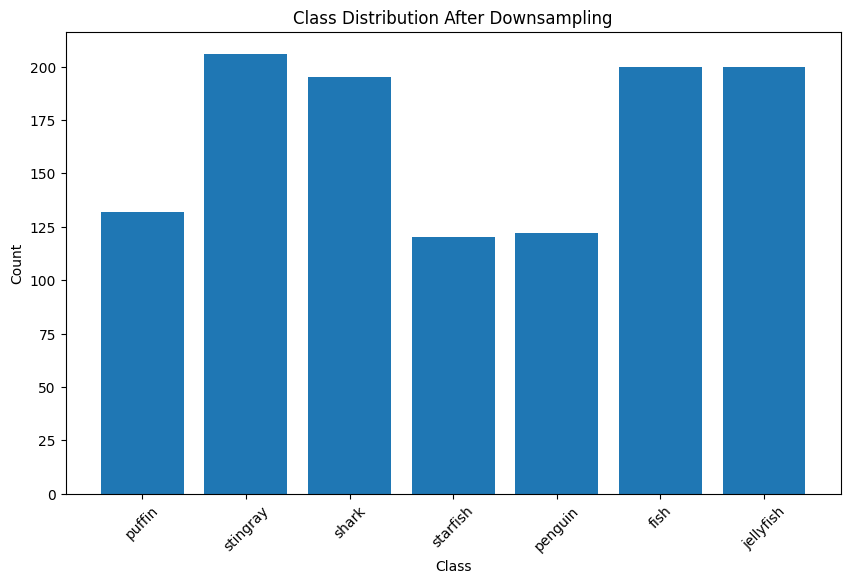

In [ ]:
# Plot the histogram
plt.figure(figsize=(10, 6))
plt.bar(class_names, counts)
plt.xlabel('Class')
plt.ylabel('Count')
plt.title('Class Distribution After Downsampling')
plt.xticks(rotation=45)
plt.show()

In [ ]:
import shutil
shutil.make_archive('/content/Aquarium/valid','zip','/content/Aquarium/valid')

'/content/Aquarium/valid.zip'

In [ ]:
from google.colab import files

files.download('/content/Aquarium/test.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from google.colab import files

files.download('/content/Aquarium/valid.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from google.colab import files

files.download('/content/Aquarium/new_train.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Resizing images**


**Note** Decide on the size here i used 224 by 224

In [ ]:
import cv2
import os
import numpy as np

def load_and_resize_images(image_dir, target_shape):
    images = []
    for image_name in os.listdir(image_dir):
        if image_name.startswith('.') or image_name.endswith('_aug_annotations.json'):
            continue  # Skip hidden files and files with "_aug_annotations.json" suffix
        image_path = os.path.join(image_dir, image_name)
        if os.path.isfile(image_path):
            # Load the image
            image = cv2.imread(image_path)
            if image is None:
                print(f"Failed to load image: {image_path}")
            else:
                # Resize the image to the target shape
                image = cv2.resize(image, (target_shape[1], target_shape[0]))
                # Convert the image from BGR to RGB
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                # Append the image to the list
                images.append(image)
    # Convert the list of images to a numpy array
    images = np.array(images)
    return images

# Define the target shape (32, 32, 3)
target_shape = (224, 224, 3)

# Load and resize images for train, test, and validation sets

train_images = load_and_resize_images('/content/Aquarium/new_train', target_shape)

valid_images = load_and_resize_images('/content/Aquarium/valid', target_shape)
test_images = load_and_resize_images('/content/Aquarium/test', target_shape)

# Print the shapes of the resulting arrays
print(f"Train images shape: {train_images.shape}")
print(f"Validation images shape: {valid_images.shape}")
print(f"Test images shape: {test_images.shape}")

Failed to load image: /content/Aquarium/train/_annotations.coco.json
Failed to load image: /content/Aquarium/valid/_annotations.coco.json
Failed to load image: /content/Aquarium/test/_annotations.coco.json
Train images shape: (448, 224, 224, 3)
Validation images shape: (127, 224, 224, 3)
Test images shape: (63, 224, 224, 3)


In [ ]:
import json

def load_labels(json_path):
    with open(json_path, 'r') as f:
        data = json.load(f)
    labels = []
    for item in data['annotations']:
        labels.append(item['category_id'])
    return np.array(labels)

# Load labels for train, validation, and test sets
y_train = load_labels('/content/Aquarium/new_train/final_annotations.coco.json')
y_valid = load_labels('/content/Aquarium/valid/_annotations.coco.json')
y_test = load_labels('/content/Aquarium/test/_annotations.coco.json')

In [ ]:
X_train = train_images
print(X_train)

[[[[ 18  55  71]
   [ 18  55  71]
   [ 18  55  71]
   ...
   [ 22  61  78]
   [ 23  61  79]
   [ 21  60  77]]

  [[ 18  55  71]
   [ 18  55  71]
   [ 18  55  71]
   ...
   [ 21  60  77]
   [ 21  60  77]
   [ 23  62  79]]

  [[ 18  55  71]
   [ 19  56  72]
   [ 18  55  71]
   ...
   [ 23  62  79]
   [ 22  61  78]
   [ 23  62  79]]

  ...

  [[  2   2   0]
   [  2   2   0]
   [  2   2   0]
   ...
   [  1   3   0]
   [  1   3   0]
   [  1   3   0]]

  [[  4   4   2]
   [  3   3   1]
   [  2   2   0]
   ...
   [  1   3   0]
   [  1   3   0]
   [  1   3   0]]

  [[  4   4   2]
   [  3   3   1]
   [  2   2   0]
   ...
   [  1   3   0]
   [  1   3   0]
   [  1   3   0]]]


 [[[ 61  62  57]
   [ 65  66  61]
   [ 62  63  58]
   ...
   [ 31  24   8]
   [ 36  31   5]
   [ 24  27   3]]

  [[ 57  59  54]
   [ 59  60  55]
   [ 65  65  60]
   ...
   [ 39  44  30]
   [ 33  31  12]
   [ 15  16   0]]

  [[ 57  58  53]
   [ 60  61  56]
   [ 59  60  55]
   ...
   [ 48  62  47]
   [ 32  33  18]
   [ 33  32

In [ ]:
X_test = test_images
print(X_test)

[[[[ 84  96 111]
   [ 92 104 118]
   [ 94 105 120]
   ...
   [112 120 166]
   [112 121 163]
   [113 122 162]]

  [[ 84  95 116]
   [ 83  94 115]
   [ 82  93 113]
   ...
   [111 120 159]
   [111 121 157]
   [111 121 156]]

  [[ 77  87 114]
   [ 77  87 115]
   [ 78  87 115]
   ...
   [ 98 108 145]
   [118 128 163]
   [118 129 161]]

  ...

  [[117 159 137]
   [111 152 133]
   [108 149 133]
   ...
   [ 12  49  57]
   [ 12  49  57]
   [ 15  52  60]]

  [[122 164 142]
   [112 154 133]
   [112 154 138]
   ...
   [ 17  52  58]
   [ 19  54  60]
   [ 21  56  62]]

  [[118 160 138]
   [117 159 139]
   [108 149 133]
   ...
   [ 17  52  58]
   [ 20  55  61]
   [ 22  57  63]]]


 [[[ 13  13  15]
   [ 28  29  31]
   [ 21  22  24]
   ...
   [ 18  13  10]
   [ 16  11   8]
   [ 17  12   9]]

  [[ 12   7   8]
   [ 31  26  27]
   [ 18  14  14]
   ...
   [ 19  14  11]
   [ 13   8   5]
   [ 14   9   6]]

  [[ 98  87  85]
   [ 74  63  61]
   [ 66  55  53]
   ...
   [ 21  16  13]
   [ 16  11   8]
   [ 12   7

In [ ]:
X_valid = valid_images
print(X_valid)

[[[[ 38  35  50]
   [ 37  33  48]
   [ 33  29  44]
   ...
   [ 79  93 203]
   [ 74  96 177]
   [100 118 162]]

  [[ 36  32  47]
   [ 36  32  47]
   [ 36  32  47]
   ...
   [ 89 113 187]
   [ 87 114 132]
   [ 90 109 107]]

  [[ 30  26  41]
   [ 39  35  50]
   [ 36  31  47]
   ...
   [ 86 107 189]
   [100 120 133]
   [ 94 108 119]]

  ...

  [[ 29  28  33]
   [ 35  34  39]
   [ 30  29  34]
   ...
   [198 227 196]
   [212 241 210]
   [215 244 213]]

  [[ 38  37  42]
   [ 14  13  18]
   [ 41  40  45]
   ...
   [207 236 205]
   [213 242 211]
   [214 243 212]]

  [[ 35  34  39]
   [ 30  29  34]
   [ 43  42  47]
   ...
   [202 231 200]
   [211 240 209]
   [213 242 211]]]


 [[[ 10  55 149]
   [  9  53 150]
   [  8  52 151]
   ...
   [ 98 120 156]
   [106 128 167]
   [112 135 174]]

  [[ 42  87 181]
   [ 11  56 149]
   [ 12  57 150]
   ...
   [ 72  89 133]
   [ 80  97 136]
   [ 90 106 143]]

  [[ 38  85 165]
   [ 24  71 150]
   [ 15  60 151]
   ...
   [ 57  69 119]
   [ 53  60 111]
   [ 45  48

**Pixel Values for Images before Normalization**

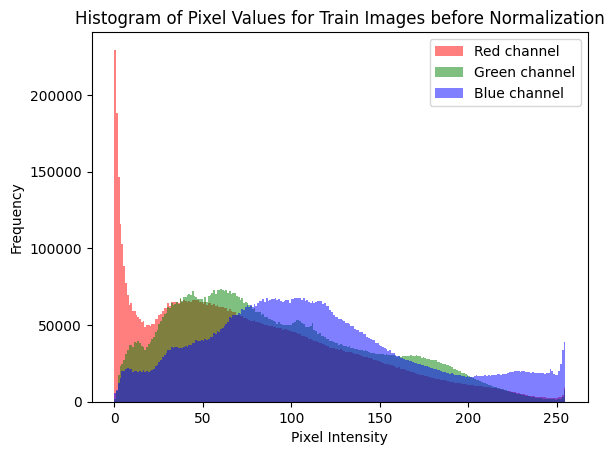

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Flatten the pixel values for each channel to create a 1D array for each channel Since each image in CIFAR-10 is 32x32 pixels and has 3 color channels (RGB).
red_channel_train = X_train[:,:,:,0].flatten()
green_channel_train = X_train[:,:,:,1].flatten()
blue_channel_train = X_train[:,:,:,2].flatten()

#I created histogram for each color channel to visualize the distribution of pixel values.

plt.hist(red_channel_train, bins=256, color='red', alpha=0.5, label='Red channel')
plt.hist(green_channel_train, bins=256, color='green', alpha=0.5, label='Green channel')
plt.hist(blue_channel_train, bins=256, color='blue', alpha=0.5, label='Blue channel')
plt.title('Histogram of Pixel Values for Train Images before Normalization')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.legend()
plt.show()

In [ ]:
import numpy as np

red_summary = np.percentile(red_channel_train, [0, 25, 50, 75, 100])
green_summary = np.percentile(green_channel_train, [0, 25, 50, 75, 100])
blue_summary = np.percentile(blue_channel_train, [0, 25, 50, 75, 100])

print("Red channel summary (Min, Q1, Median, Q3, Max):", red_summary)
print("Green channel summary (Min, Q1, Median, Q3, Max):", green_summary)
print("Blue channel summary (Min, Q1, Median, Q3, Max):", blue_summary)

Red channel summary (Min, Q1, Median, Q3, Max): [  0.  31.  68. 116. 255.]
Green channel summary (Min, Q1, Median, Q3, Max): [  0.  48.  83. 132. 255.]
Blue channel summary (Min, Q1, Median, Q3, Max): [  0.  70. 106. 149. 255.]


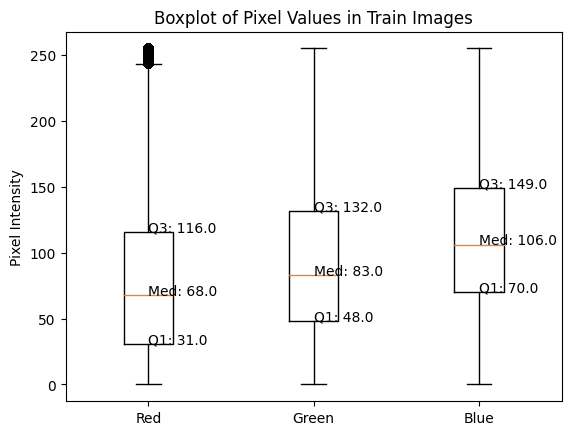

In [ ]:
plt.boxplot([red_channel_train, green_channel_train, blue_channel_train], labels=['Red', 'Green', 'Blue'])
plt.title('Boxplot of Pixel Values in Train Images')
plt.ylabel('Pixel Intensity')

plt.text(1, red_summary[3], f'Q3: {red_summary[3]}')
plt.text(1, red_summary[2], f'Med: {red_summary[2]}')
plt.text(1, red_summary[1], f'Q1: {red_summary[1]}')

plt.text(2, green_summary[3], f'Q3: {green_summary[3]}')
plt.text(2, green_summary[2], f'Med: {green_summary[2]}')
plt.text(2, green_summary[1], f'Q1: {green_summary[1]}')

plt.text(3, blue_summary[3], f'Q3: {blue_summary[3]}')
plt.text(3, blue_summary[2], f'Med: {blue_summary[2]}')
plt.text(3, blue_summary[1], f'Q1: {blue_summary[1]}')

plt.show()

**Then for Valid**

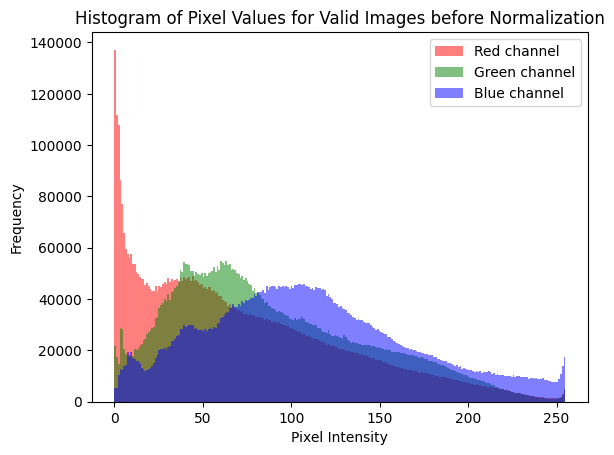

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Flatten the pixel values for each channel to create a 1D array for each channel Since each image in CIFAR-10 is 32x32 pixels and has 3 color channels (RGB).
red_channel_valid = X_valid[:,:,:,0].flatten()
green_channel_valid = X_valid[:,:,:,1].flatten()
blue_channel_valid = X_valid[:,:,:,2].flatten()

#I created histogram for each color channel to visualize the distribution of pixel values.

plt.hist(red_channel_valid, bins=256, color='red', alpha=0.5, label='Red channel')
plt.hist(green_channel_valid, bins=256, color='green', alpha=0.5, label='Green channel')
plt.hist(blue_channel_valid, bins=256, color='blue', alpha=0.5, label='Blue channel')
plt.title('Histogram of Pixel Values for Valid Images before Normalization')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.legend()
plt.show()

In [ ]:
import numpy as np

red_summary = np.percentile(red_channel_valid, [0, 25, 50, 75, 100])
green_summary = np.percentile(green_channel_valid, [0, 25, 50, 75, 100])
blue_summary = np.percentile(blue_channel_valid, [0, 25, 50, 75, 100])

print("Red channel summary (Min, Q1, Median, Q3, Max):", red_summary)
print("Green channel summary (Min, Q1, Median, Q3, Max):", green_summary)
print("Blue channel summary (Min, Q1, Median, Q3, Max):", blue_summary)

Red channel summary (Min, Q1, Median, Q3, Max): [  0.  26.  61. 110. 255.]
Green channel summary (Min, Q1, Median, Q3, Max): [  0.  46.  78. 126. 255.]
Blue channel summary (Min, Q1, Median, Q3, Max): [  0.  68. 106. 148. 255.]


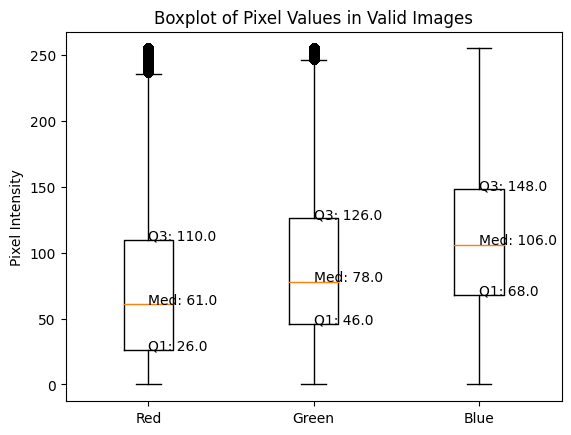

In [ ]:
plt.boxplot([red_channel_valid, green_channel_valid, blue_channel_valid], labels=['Red', 'Green', 'Blue'])
plt.title('Boxplot of Pixel Values in Valid Images')
plt.ylabel('Pixel Intensity')

plt.text(1, red_summary[3], f'Q3: {red_summary[3]}')
plt.text(1, red_summary[2], f'Med: {red_summary[2]}')
plt.text(1, red_summary[1], f'Q1: {red_summary[1]}')

plt.text(2, green_summary[3], f'Q3: {green_summary[3]}')
plt.text(2, green_summary[2], f'Med: {green_summary[2]}')
plt.text(2, green_summary[1], f'Q1: {green_summary[1]}')

plt.text(3, blue_summary[3], f'Q3: {blue_summary[3]}')
plt.text(3, blue_summary[2], f'Med: {blue_summary[2]}')
plt.text(3, blue_summary[1], f'Q1: {blue_summary[1]}')

plt.show()

**Then for Test images**

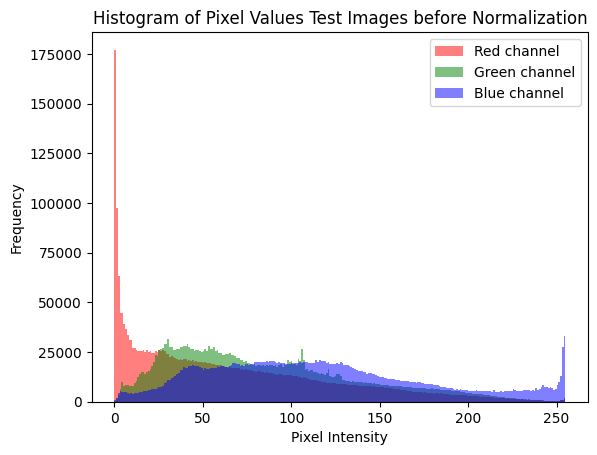

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Flatten the pixel values for each channel to create a 1D array for each channel Since each image in CIFAR-10 is 32x32 pixels and has 3 color channels (RGB).
red_channel_test = X_test[:,:,:,0].flatten()
green_channel_test = X_test[:,:,:,1].flatten()
blue_channel_test = X_test[:,:,:,2].flatten()

#I created histogram for each color channel to visualize the distribution of pixel values.

plt.hist(red_channel_test, bins=256, color='red', alpha=0.5, label='Red channel')
plt.hist(green_channel_test, bins=256, color='green', alpha=0.5, label='Green channel')
plt.hist(blue_channel_test, bins=256, color='blue', alpha=0.5, label='Blue channel')
plt.title('Histogram of Pixel Values Test Images before Normalization')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.legend()
plt.show()

In [ ]:
import numpy as np

# Assuming red_channel_test, green_channel_test, blue_channel_test are your data arrays
red_summary = np.percentile(red_channel_test, [0, 25, 50, 75, 100])
green_summary = np.percentile(green_channel_test, [0, 25, 50, 75, 100])
blue_summary = np.percentile(blue_channel_test, [0, 25, 50, 75, 100])

print("Red channel summary (Min, Q1, Median, Q3, Max):", red_summary)
print("Green channel summary (Min, Q1, Median, Q3, Max):", green_summary)
print("Blue channel summary (Min, Q1, Median, Q3, Max):", blue_summary)

Red channel summary (Min, Q1, Median, Q3, Max): [  0.  17.  52. 101. 255.]
Green channel summary (Min, Q1, Median, Q3, Max): [  0.  43.  75. 119. 255.]
Blue channel summary (Min, Q1, Median, Q3, Max): [  0.  68. 108. 154. 255.]


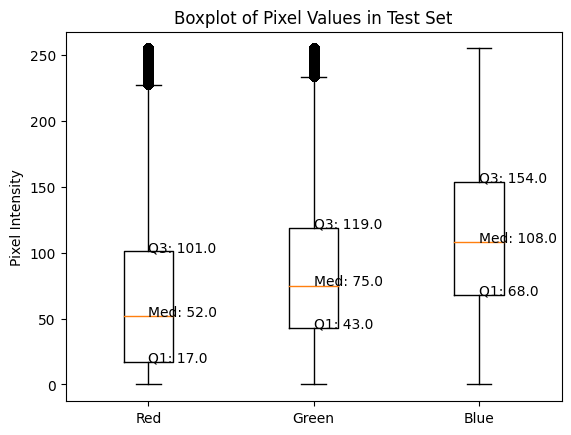

In [ ]:
plt.boxplot([red_channel_test, green_channel_test, blue_channel_test], labels=['Red', 'Green', 'Blue'])
plt.title('Boxplot of Pixel Values in Test Set')
plt.ylabel('Pixel Intensity')

plt.text(1, red_summary[3], f'Q3: {red_summary[3]}')
plt.text(1, red_summary[2], f'Med: {red_summary[2]}')
plt.text(1, red_summary[1], f'Q1: {red_summary[1]}')

plt.text(2, green_summary[3], f'Q3: {green_summary[3]}')
plt.text(2, green_summary[2], f'Med: {green_summary[2]}')
plt.text(2, green_summary[1], f'Q1: {green_summary[1]}')

plt.text(3, blue_summary[3], f'Q3: {blue_summary[3]}')
plt.text(3, blue_summary[2], f'Med: {blue_summary[2]}')
plt.text(3, blue_summary[1], f'Q1: {blue_summary[1]}')
plt.show()

**NORMALIZATION**

In [ ]:
X_train_normalized = X_train / 255.0
X_test_normalized = X_test / 255.0
X_valid_normalized = X_valid / 255.0

In [ ]:
print(X_train_normalized)

[[[[0.03529412 0.11372549 0.14117647]
   [0.04313725 0.12156863 0.14901961]
   [0.03529412 0.11372549 0.14117647]
   ...
   [0.31764706 0.30980392 0.25882353]
   [0.20784314 0.2        0.15686275]
   [0.3254902  0.35686275 0.27058824]]

  [[0.04705882 0.1254902  0.15294118]
   [0.04313725 0.12156863 0.14901961]
   [0.04313725 0.1254902  0.15294118]
   ...
   [0.20392157 0.19215686 0.1372549 ]
   [0.30196078 0.28627451 0.24313725]
   [0.65490196 0.67843137 0.59607843]]

  [[0.05098039 0.12941176 0.15686275]
   [0.03137255 0.10980392 0.1372549 ]
   [0.01960784 0.09803922 0.1254902 ]
   ...
   [0.34509804 0.31764706 0.2627451 ]
   [0.42745098 0.40784314 0.35294118]
   [0.61960784 0.63137255 0.56470588]]

  ...

  [[0.01568627 0.03529412 0.04705882]
   [0.00392157 0.02352941 0.03529412]
   [0.01568627 0.03529412 0.04705882]
   ...
   [0.00392157 0.01960784 0.02352941]
   [0.00392157 0.01960784 0.02352941]
   [0.00392157 0.01960784 0.02352941]]

  [[0.02352941 0.04313725 0.05490196]
   [0.0

In [ ]:
print(X_train.shape)

(448, 224, 224, 3)


In [ ]:
print(X_train_normalized.shape)

(448, 224, 224, 3)


The shape of X_train_normalized will remain the same as X_train. So, after normalization, the shape will still be (524, 224, 224, 3).

Normalization scales the pixel values but does not change the dimensions of the array.

In [ ]:
print(X_test_normalized)

[[[[0.16862745 0.25882353 0.        ]
   [0.21568627 0.30588235 0.04313725]
   [0.18823529 0.28627451 0.02745098]
   ...
   [0.19215686 0.30980392 0.30980392]
   [0.17254902 0.29803922 0.29803922]
   [0.15686275 0.28235294 0.29019608]]

  [[0.18431373 0.29019608 0.02745098]
   [0.19607843 0.29803922 0.03921569]
   [0.2745098  0.37254902 0.11764706]
   ...
   [0.26666667 0.37647059 0.38823529]
   [0.23137255 0.34509804 0.35686275]
   [0.16862745 0.28235294 0.29803922]]

  [[0.23529412 0.35686275 0.09411765]
   [0.20392157 0.31372549 0.0627451 ]
   [0.19607843 0.29411765 0.05490196]
   ...
   [0.23529412 0.33333333 0.35294118]
   [0.18823529 0.29411765 0.31764706]
   [0.17647059 0.28235294 0.30980392]]

  ...

  [[0.05098039 0.08235294 0.03921569]
   [0.04705882 0.0745098  0.03529412]
   [0.03529412 0.06666667 0.02352941]
   ...
   [0.03921569 0.06666667 0.03529412]
   [0.02745098 0.05490196 0.02352941]
   [0.03529412 0.0627451  0.03137255]]

  [[0.04705882 0.06666667 0.03921569]
   [0.0

In [ ]:
print(X_valid_normalized)

[[[[0.22352941 0.24705882 0.76078431]
   [0.21568627 0.27058824 0.74901961]
   [0.18039216 0.25490196 0.69803922]
   ...
   [0.17647059 0.24705882 0.63137255]
   [0.16078431 0.23137255 0.61568627]
   [0.15294118 0.22352941 0.60784314]]

  [[0.16078431 0.17254902 0.96078431]
   [0.14117647 0.15686275 0.9254902 ]
   [0.2        0.22352941 0.98039216]
   ...
   [0.17254902 0.24313725 0.62352941]
   [0.16078431 0.22745098 0.61176471]
   [0.14901961 0.21960784 0.60392157]]

  [[0.29803922 0.50980392 0.97647059]
   [0.32156863 0.51764706 0.98823529]
   [0.28235294 0.45490196 0.95294118]
   ...
   [0.16470588 0.23137255 0.61568627]
   [0.15294118 0.22352941 0.60784314]
   [0.16470588 0.23921569 0.62352941]]

  ...

  [[0.15294118 0.18431373 0.36862745]
   [0.14509804 0.17647059 0.36078431]
   [0.10980392 0.14117647 0.3254902 ]
   ...
   [0.20392157 0.25098039 0.44705882]
   [0.18823529 0.23529412 0.43137255]
   [0.18039216 0.22745098 0.42352941]]

  [[0.1372549  0.16862745 0.35294118]
   [0.1

**REMEMBER TO ADD THE RGB AFTER NORMALIZATION**

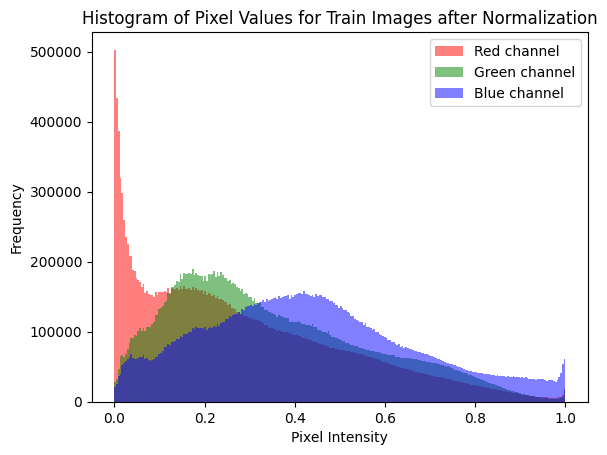

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Flatten the pixel values for each channel to create a 1D array for each channel Since each image in CIFAR-10 is 32x32 pixels and has 3 color channels (RGB).
red_channel_train = X_train_normalized[:,:,:,0].flatten()
green_channel_train = X_train_normalized[:,:,:,1].flatten()
blue_channel_train = X_train_normalized[:,:,:,2].flatten()

#I created histogram for each color channel to visualize the distribution of pixel values.

plt.hist(red_channel_train, bins=256, color='red', alpha=0.5, label='Red channel')
plt.hist(green_channel_train, bins=256, color='green', alpha=0.5, label='Green channel')
plt.hist(blue_channel_train, bins=256, color='blue', alpha=0.5, label='Blue channel')
plt.title('Histogram of Pixel Values for Train Images after Normalization')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.legend()
plt.show()

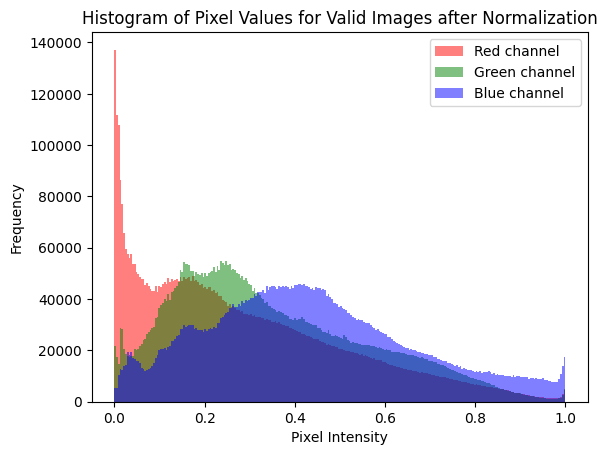

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Flatten the pixel values for each channel to create a 1D array for each channel Since each image in CIFAR-10 is 32x32 pixels and has 3 color channels (RGB).
red_channel_valid = X_valid_normalized[:,:,:,0].flatten()
green_channel_valid = X_valid_normalized[:,:,:,1].flatten()
blue_channel_valid = X_valid_normalized[:,:,:,2].flatten()

#I created histogram for each color channel to visualize the distribution of pixel values.

plt.hist(red_channel_valid, bins=256, color='red', alpha=0.5, label='Red channel')
plt.hist(green_channel_valid, bins=256, color='green', alpha=0.5, label='Green channel')
plt.hist(blue_channel_valid, bins=256, color='blue', alpha=0.5, label='Blue channel')
plt.title('Histogram of Pixel Values for Valid Images after Normalization')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.legend()
plt.show()

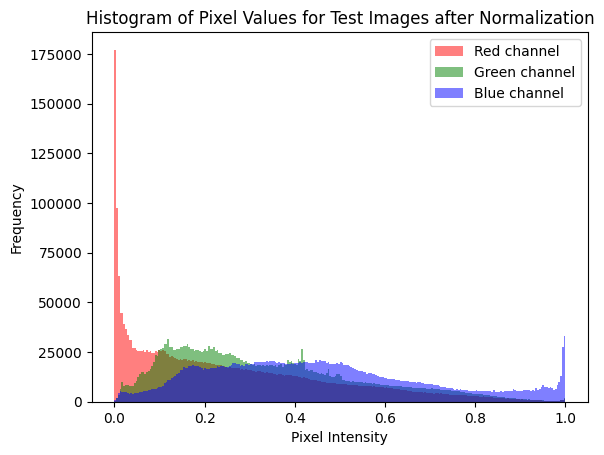

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Flatten the pixel values for each channel to create a 1D array for each channel Since each image in CIFAR-10 is 32x32 pixels and has 3 color channels (RGB).
red_channel_test = X_test_normalized[:,:,:,0].flatten()
green_channel_test = X_test_normalized[:,:,:,1].flatten()
blue_channel_test = X_test_normalized[:,:,:,2].flatten()

#I created histogram for each color channel to visualize the distribution of pixel values.

plt.hist(red_channel_test, bins=256, color='red', alpha=0.5, label='Red channel')
plt.hist(green_channel_test, bins=256, color='green', alpha=0.5, label='Green channel')
plt.hist(blue_channel_test, bins=256, color='blue', alpha=0.5, label='Blue channel')
plt.title('Histogram of Pixel Values for Test Images after Normalization')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.legend()
plt.show()

**MODEL TRAINING**

**SETTING UP YOLOV8**


In [ ]:
!pip install opencv-python

In [ ]:
!pip install ultralytics

**Initiate the training of a YOLOv8 model for object detection**

In [ ]:
!yolo task=detect mode=train model=yolov8n.pt data='/content/Dataset/yolo_dataset/data.yaml' epochs=50

100% 6.25M/6.25M [00:00<00:00, 23.2MB/s]
New https://pypi.org/project/ultralytics/8.3.17 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.16 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/Dataset/yolo_dataset/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retin

**Notes**
1.
Image Sizes:
•  Training and validation image sizes are both set to 640 pixels.
2.
Optimizer:
•  The optimizer used is AdamW with a learning rate of 0.000909 and momentum of 0.9.
3.
Model Summary:
•  The model has 186 layers, 2,685,733 parameters, 0 gradients.

•  The model's GFLOPs (Giga Floating Point Operations per Second) is 6.8.

1.
Training Configuration:
•  Epochs: 50

•  Batch size: 16

•  Workers: 8

•  Image Size: 640x640

•  Patience: 100

•  Device: CPU (Intel Xeon 2.20GHz)

•  Pretrained: True

•  Deterministic: True

•  Mixed Precision (AMP): Enabled

1.
Data Augmentation:
•  Various augmentations are applied, including Blur, MedianBlur, ToGray, and CLAHE.
i.e Augmentations Applied
•  Blur: p=0.01, blur_limit=(3, 7)

•  MedianBlur: p=0.01, blur_limit=(3, 7)

•  ToGray: p=0.01, num_output_channels=3

•  CLAHE: p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8)


2.
Losses:
•  The output shows the box loss, classification loss, and distribution focal loss (dfl) for each epoch.


3.Performance Metrics

•  mAP50: 0.757

•  mAP50-95: 0.451

•  Precision: 0.837

•  Recall: 0.662

4.Class-wise Performance


•  Fish: mAP50-95 = 0.443

•  Jellyfish: mAP50-95 = 0.536

•  Penguin: mAP50-95 = 0.338

•  Puffin: mAP50-95 = 0.255

•  Shark: mAP50-95 = 0.402

•  Starfish: mAP50-95 = 0.586

•  Stingray: mAP50-95 = 0.594



50 epochs completed in 5.608 hours.


**Visualization of Graphs from Training**

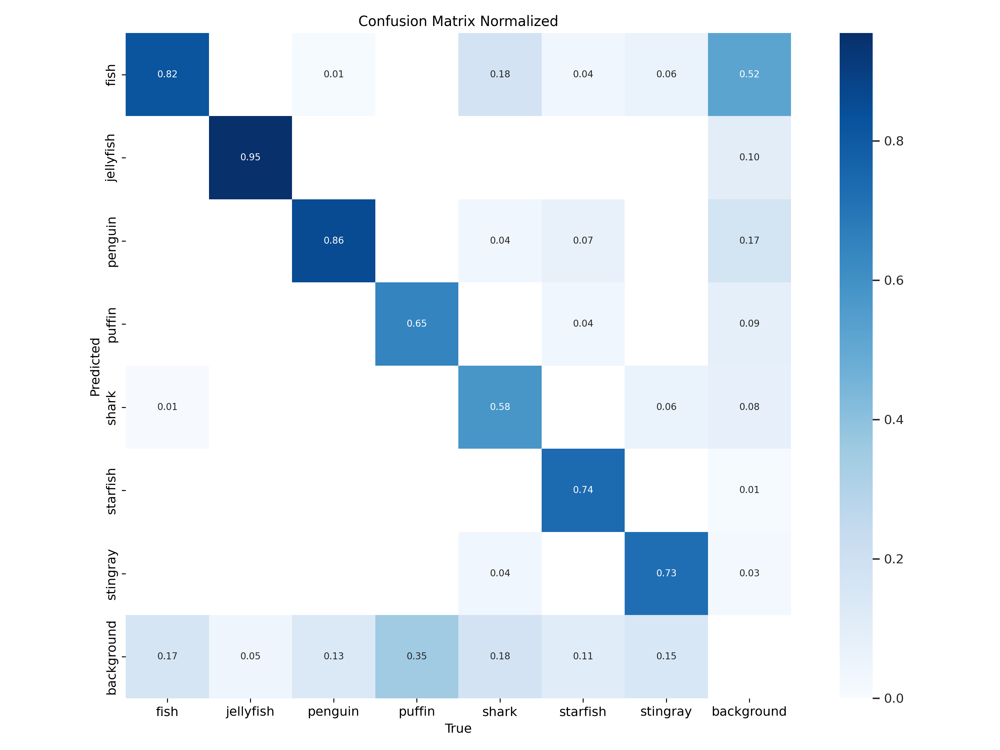

In [ ]:
Image(filename =f'/content/runs/detect/train/confusion_matrix_normalized.png' )

**Notes**

•  Y-axis (Predicted): The classes predicted by our model.

•  X-axis (True): The actual classes from our dataset.

•  Diagonal Values: These represent the number of correct predictions for each class. for example : The value in the cell where the row for "Fish" intersects with the column for "Fish" is 0.82 which indicates how many times the model correctly predicted "Fish" when the true class was "Fish".


Off-Diagonal Values: These represent misclassifications. For example we have 0.01 on the row for "Fish" intersecting with the column for "shark" and it indicates the number of times the model predicted "shark" when the true class was "Fish".

**Strong Performance:** The model seems to perform well in classifying "fish",jellyfish" and "penguin."

**Confusion with "fish":** The model frequently confuses "fish" with other classes, particularly "jellyfish" and "background."

The confusion with the background is happening with most classes and that could be due to quality of the images as model can fail to identify a class due to it looking like the background

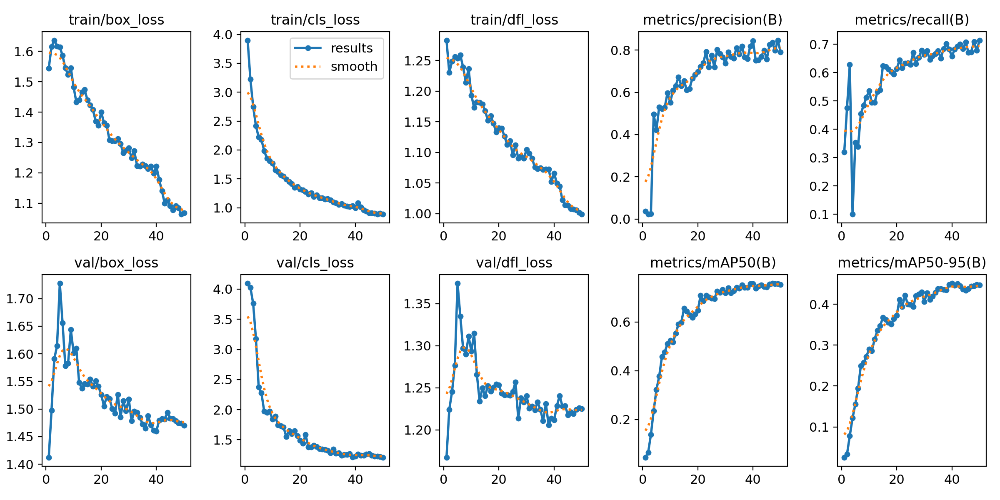

In [ ]:
Image(filename =f'/content/runs/detect/train/results.png')

This image shows the training and validation loss curves results from our YOLOv8 model, along with some metrics related to object detection performance.

**Training Loss**:

**Box Loss**: The training box loss decreases steadily, indicating that the model is improving in predicting bounding box locations.

**Class Loss**: The training class loss also decreases, showing that the model is getting better at classifying objects.

**DFL Loss**: The training dfl loss (data fidelity loss) seems to stabilize after a few epochs, suggesting that the model is learning to fit the data well.

**Validation Loss**:

**Box Loss**: The validation box loss initially decreases but then plateaus, suggesting that the model might be starting to overfit.
**Class Loss**: The validation class loss also plateaus, indicating potential overfitting.
**DFL Loss**: The validation dfl loss follows a similar trend, plateauing after a few epochs.

**Metrics**:

**Precision(B)**: The precision metric shows a general upward trend, indicating that the model is becoming more accurate in its predictions.

**Recall(B)**: The recall metric also shows an upward trend, suggesting that the model is detecting more objects.

**mAP50(B)**: The mean average precision (mAP) at 50% IoU (intersection over union) is increasing, indicating better overall performance.

**mAP50-95(B)**: The mAP at 50-95% IoU is also increasing, suggesting that the model is improving in detecting objects with higher IoU thresholds.

In [ ]:
!scp -r /content/runs '/content/Dataset/yolo_dataset'  #to make sure everything from the model goes here

In [ ]:
!zip -r /content/runs.zip /content/runs


  adding: content/runs/ (stored 0%)
  adding: content/runs/detect/ (stored 0%)
  adding: content/runs/detect/train/ (stored 0%)
  adding: content/runs/detect/train/val_batch1_labels.jpg (deflated 4%)
  adding: content/runs/detect/train/train_batch1121.jpg (deflated 11%)
  adding: content/runs/detect/train/F1_curve.png (deflated 6%)
  adding: content/runs/detect/train/val_batch1_pred.jpg (deflated 4%)
  adding: content/runs/detect/train/results.csv (deflated 61%)
  adding: content/runs/detect/train/val_batch0_pred.jpg (deflated 9%)
  adding: content/runs/detect/train/val_batch0_labels.jpg (deflated 10%)
  adding: content/runs/detect/train/labels.jpg (deflated 23%)
  adding: content/runs/detect/train/val_batch2_labels.jpg (deflated 5%)
  adding: content/runs/detect/train/train_batch2.jpg (deflated 2%)
  adding: content/runs/detect/train/confusion_matrix_normalized.png (deflated 21%)
  adding: content/runs/detect/train/labels_correlogram.jpg (deflated 36%)
  adding: content/runs/detect/tr

In [ ]:
from google.colab import files
files.download('/content/runs.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Validate YOLO model after training**

We validate the trained YOLOv8 model using the validation dataset specified in the data.yaml file. The goal here is to evaluate the model's performance metrics, such as precision, recall, and mAP (mean Average Precision), on the validation set.

In [ ]:
!yolo task=detect mode=val model=/content/runs/detect/train/weights/best.pt data='/content/Dataset/yolo_dataset/data.yaml'

Ultralytics 8.3.16 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 186 layers, 2,685,733 parameters, 0 gradients, 6.8 GFLOPs
val: Scanning /content/Dataset/yolo_dataset/valid/labels.cache... 127 images, 0 backgrounds, 0 corrupt: 100% 127/127 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 8/8 [00:30<00:00,  3.82s/it]
                   all        127        909       0.84      0.658      0.756       0.45
                  fish         63        459      0.865      0.643      0.781      0.443
             jellyfish          9        155      0.906      0.874       0.94      0.536
               penguin         17        104      0.818      0.644       0.75      0.338
                puffin         15         74      0.763      0.436      0.555       0.25
                 shark         28         57      0.771      0.509      0.664      0.402
              starfish         17         27    

**Interpretation**

Values of Precision ,Recall,mAP50 and mAP50-95 fairly good

•  Precision: Measures the accuracy of the positive predictions.

•  Recall: Measures the ability of the model to find all the relevant cases.

•  mAP50: Average precision at IoU threshold 0.5.

•  mAP50-95: Average precision across multiple IoU thresholds.

Run Inference


**Setting to prediction mode to predict images the model hasn't seen**

 We will only consider predictions with a confidence score of 0.25 or higher and the rest discarded.
 The results will include bounding boxes, class labels, and confidence scores for detected objects.

In [ ]:
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.25 source='/content/Dataset/yolo_dataset/test/images'

Ultralytics 8.3.16 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 186 layers, 2,685,733 parameters, 0 gradients, 6.8 GFLOPs

image 1/63 /content/Dataset/yolo_dataset/test/images/IMG_2289_jpeg_jpg.rf.fe2a7a149e7b11f2313f5a7b30386e85.jpg: 640x480 1 fish, 1 penguin, 171.0ms
image 2/63 /content/Dataset/yolo_dataset/test/images/IMG_2301_jpeg_jpg.rf.2c19ae5efbd1f8611b5578125f001695.jpg: 640x480 25 penguins, 156.8ms
image 3/63 /content/Dataset/yolo_dataset/test/images/IMG_2319_jpeg_jpg.rf.6e20bf97d17b74a8948aa48776c40454.jpg: 640x480 11 penguins, 144.9ms
image 4/63 /content/Dataset/yolo_dataset/test/images/IMG_2347_jpeg_jpg.rf.7c71ac4b9301eb358cd4a832844dedcb.jpg: 640x480 1 penguin, 156.9ms
image 5/63 /content/Dataset/yolo_dataset/test/images/IMG_2354_jpeg_jpg.rf.396e872c7fb0a95e911806986995ee7a.jpg: 640x480 7 penguins, 138.9ms
image 6/63 /content/Dataset/yolo_dataset/test/images/IMG_2371_jpeg_jpg.rf.54505f60b6706da151c164188c305849.jpg: 640x480 4 fishs, 14

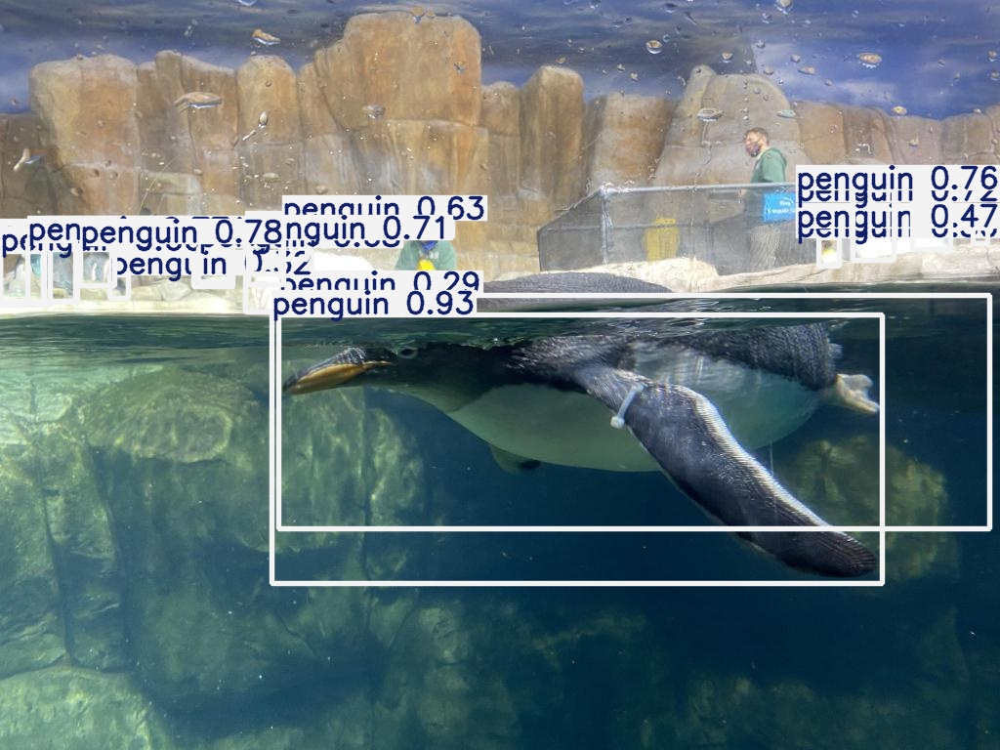

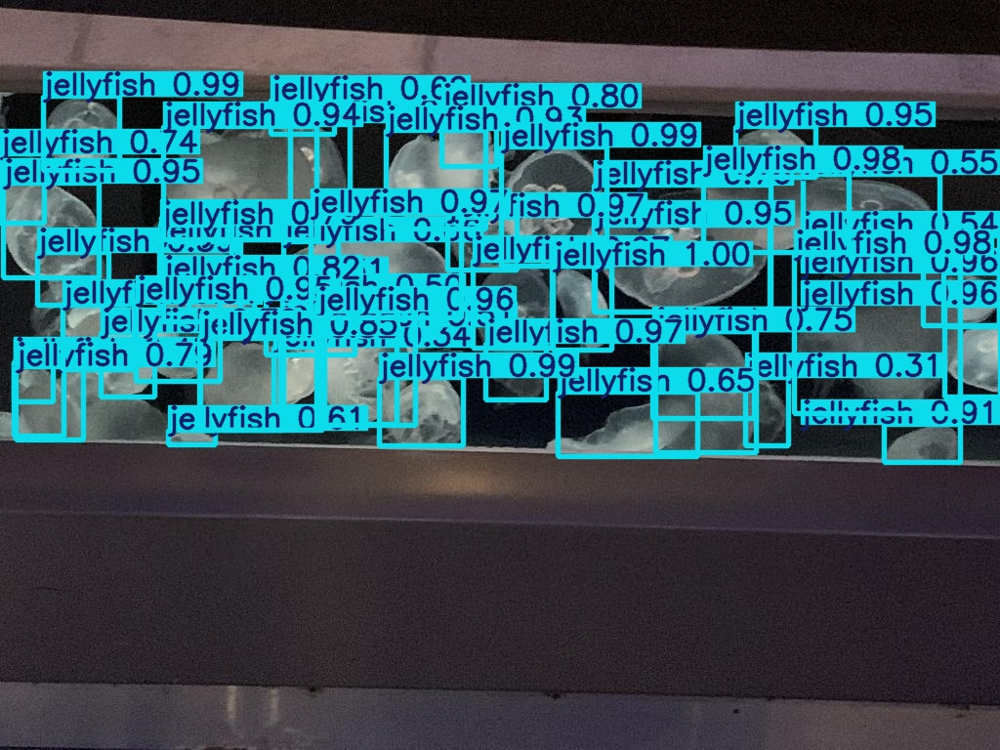

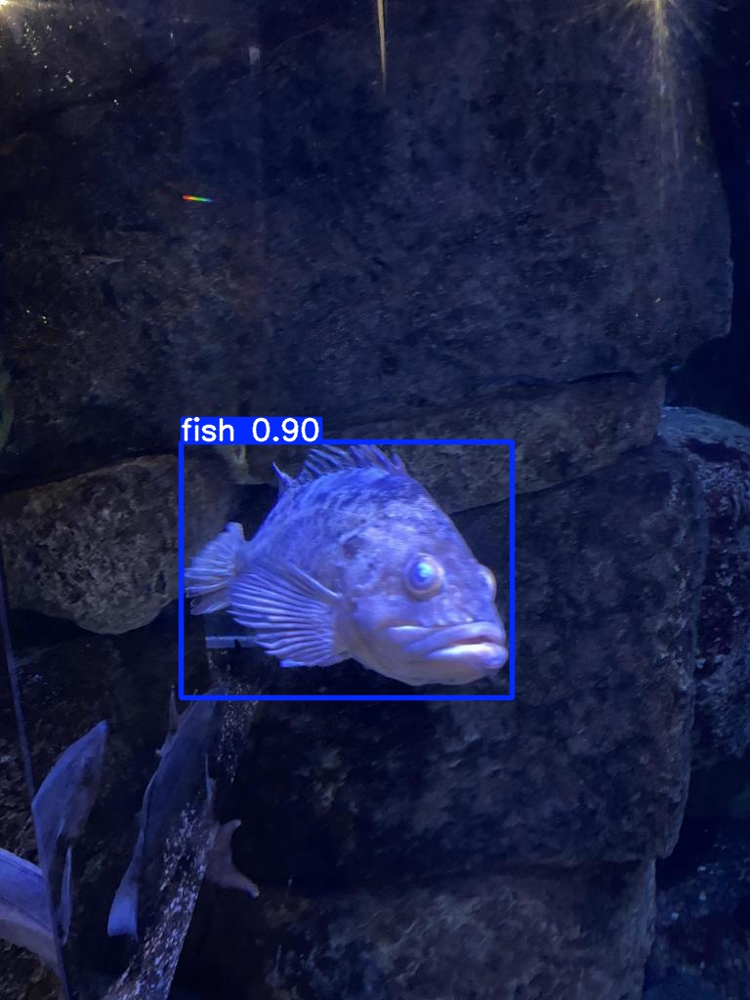

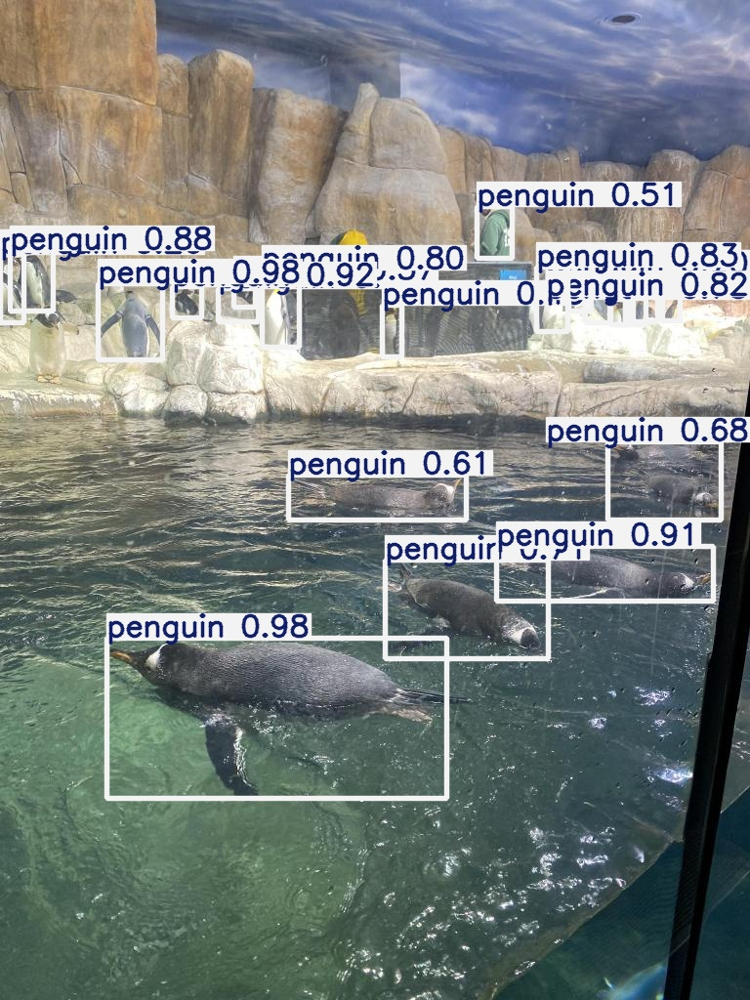

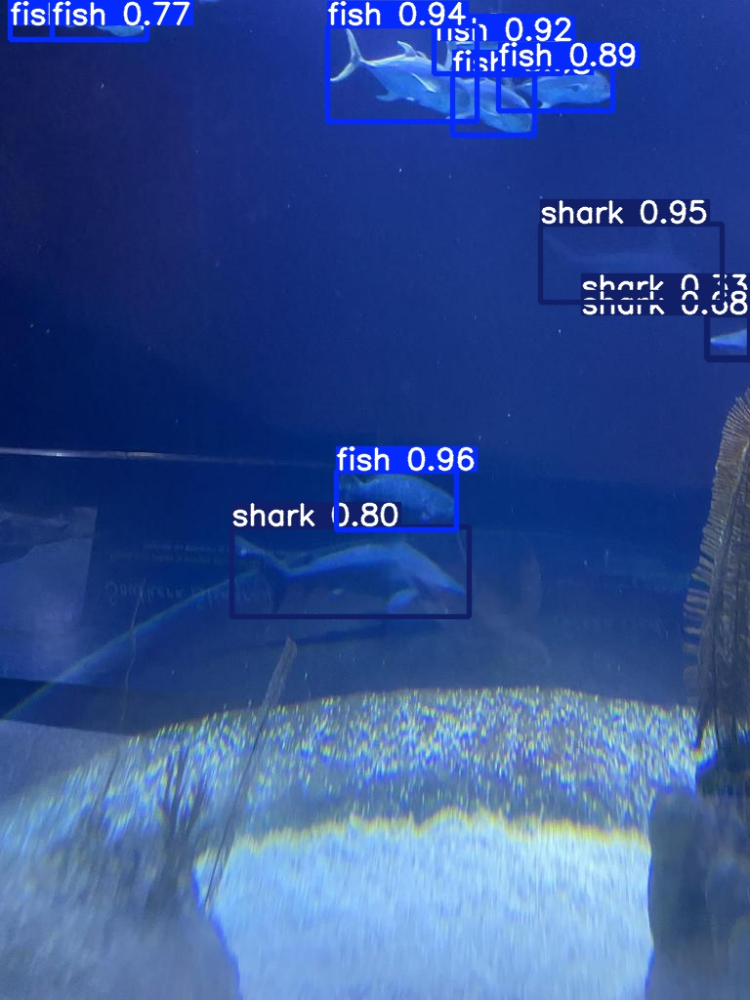

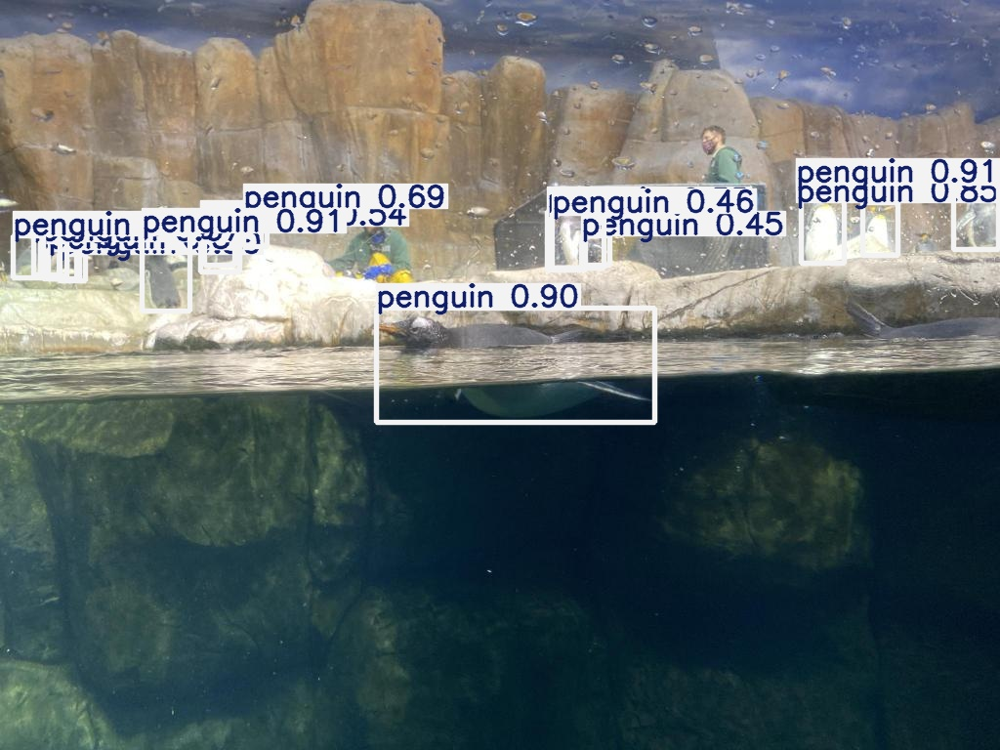

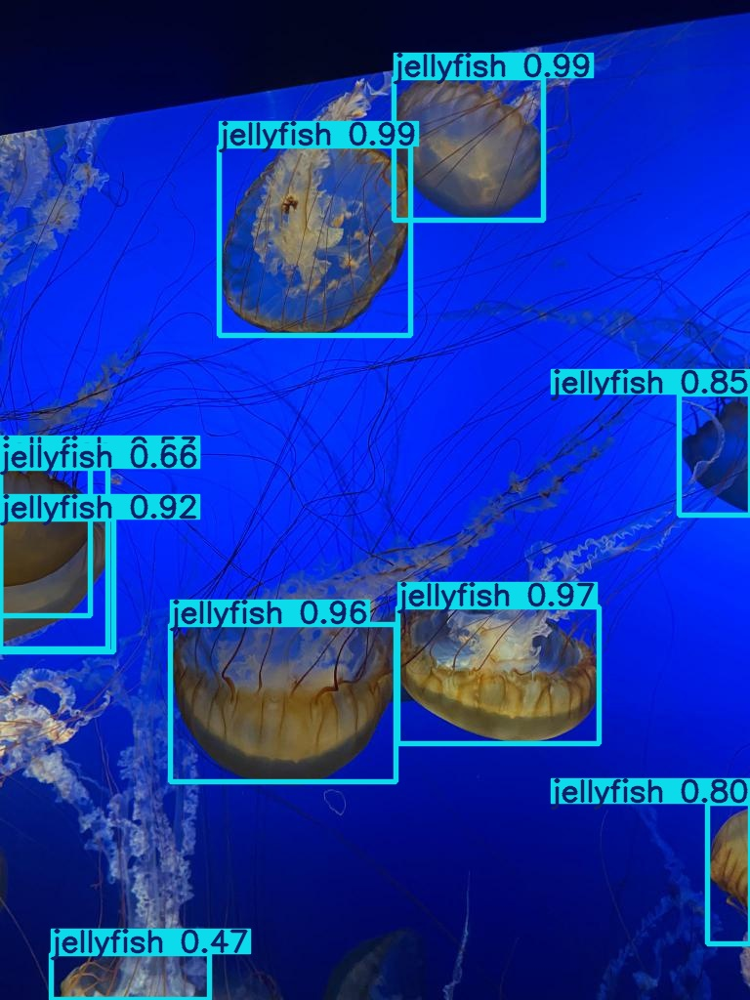

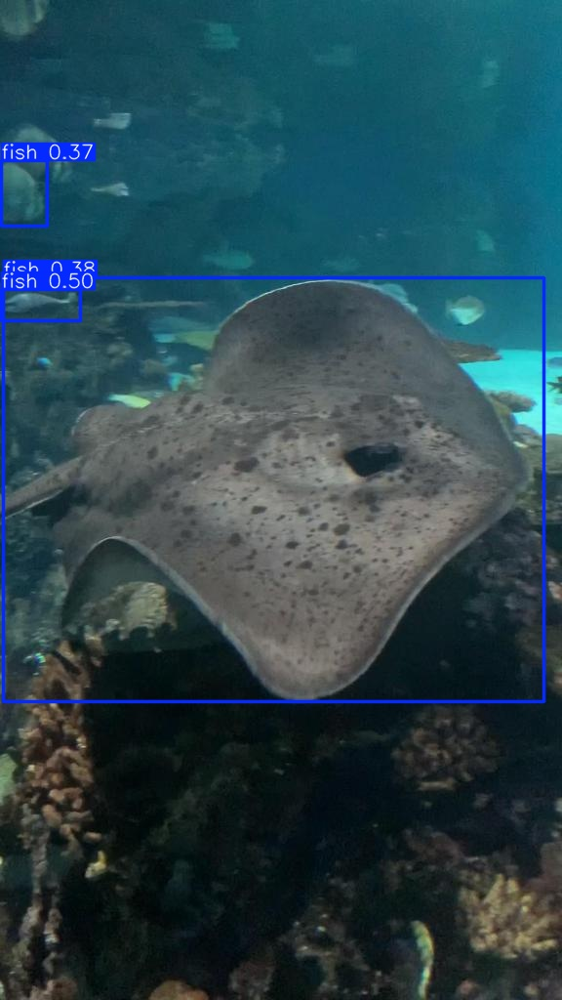

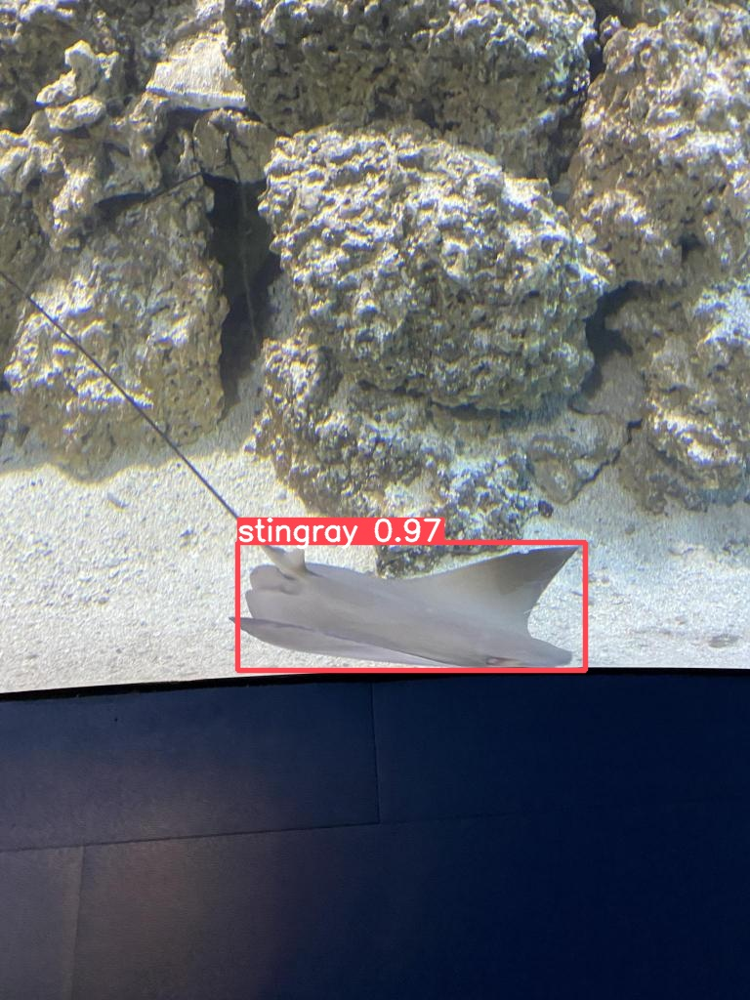

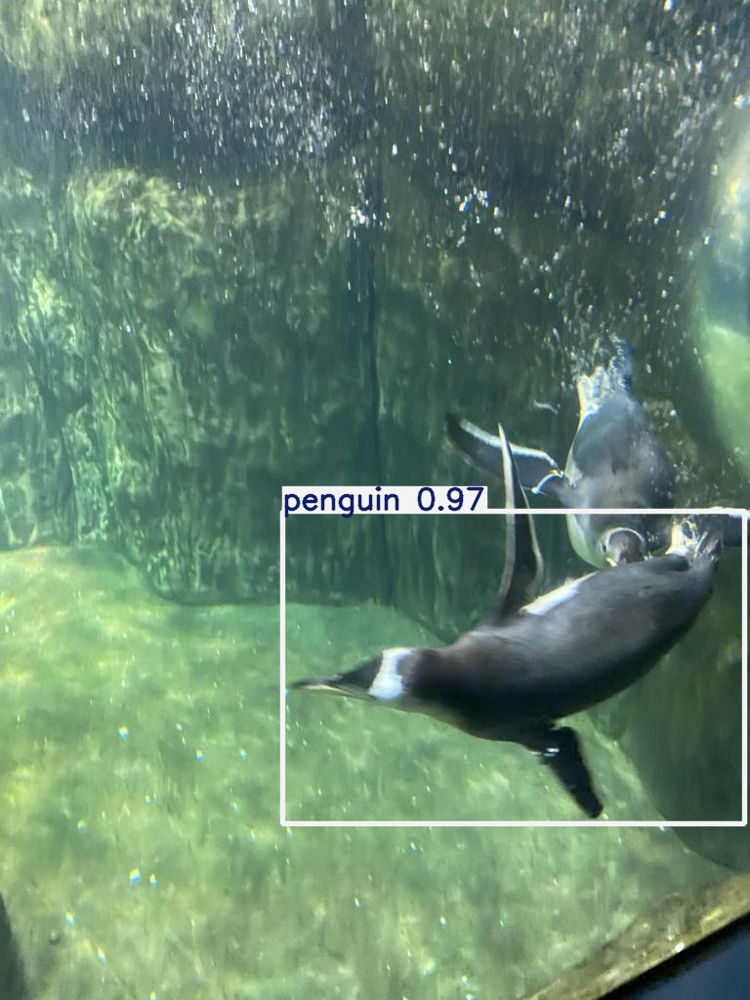

In [ ]:
import glob
from IPython.display import Image , display
for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg')[:10]:
  display(Image(filename=image_path,height=600))
  print("\n")

**TESTING WITH UNSEEN DATA FROM GOOGLE**


image 1/1 /content/puffin.jpg: 448x640 1 puffin, 247.3ms
Speed: 7.8ms preprocess, 247.3ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)


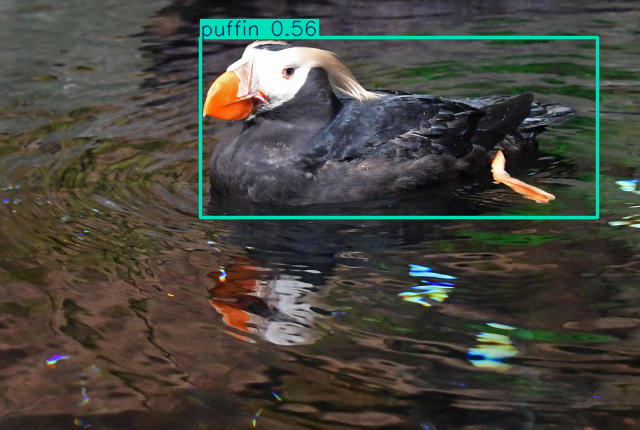

In [ ]:
# Import necessary libraries
import os
from ultralytics import YOLO

# Load the trained model
model = YOLO('/content/runs/detect/train/weights/last.pt')

# Define the path to your test image
image_path = '/content/puffin.jpg'

# Run inference on the image
results = model.predict(source=image_path)

# Display the results
for result in results:
    result.show()

**Test Environment for more unseen pictures**

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 881.2/881.2 kB 13.8 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')



Mounted at /content/drive


In [ ]:
# Extract the ZIP file into the parent folder

!mkdir -p /content/Exam


In [ ]:
!unzip /content/drive/MyDrive/runs.zip -d /content/Exam

Archive:  /content/drive/MyDrive/runs.zip
   creating: /content/Exam/content/runs/
   creating: /content/Exam/content/runs/detect/
   creating: /content/Exam/content/runs/detect/train/
  inflating: /content/Exam/content/runs/detect/train/val_batch1_labels.jpg  
  inflating: /content/Exam/content/runs/detect/train/train_batch1121.jpg  
  inflating: /content/Exam/content/runs/detect/train/F1_curve.png  
  inflating: /content/Exam/content/runs/detect/train/val_batch1_pred.jpg  
  inflating: /content/Exam/content/runs/detect/train/results.csv  
  inflating: /content/Exam/content/runs/detect/train/val_batch0_pred.jpg  
  inflating: /content/Exam/content/runs/detect/train/val_batch0_labels.jpg  
  inflating: /content/Exam/content/runs/detect/train/labels.jpg  
  inflating: /content/Exam/content/runs/detect/train/val_batch2_labels.jpg  
  inflating: /content/Exam/content/runs/detect/train/train_batch2.jpg  
  inflating: /content/Exam/content/runs/detect/train/confusion_matrix_normalized.png  

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.

image 1/1 /content/puffin.jpg: 448x640 1 puffin, 496.6ms
Speed: 9.3ms preprocess, 496.6ms inference, 37.1ms postprocess per image at shape (1, 3, 448, 640)


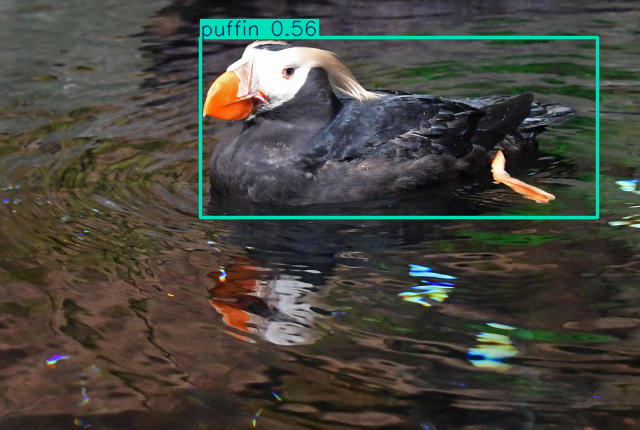

In [ ]:
# Import necessary libraries
import os
from ultralytics import YOLO

# Load the trained model
model = YOLO('/content/Exam/content/runs/detect/train/weights/last.pt')

# Define the path to your test image
image_path = '/content/puffin.jpg'

# Run inference on the image
results = model.predict(source=image_path)

# Display the results
for result in results:
    result.show()


image 1/1 /content/starfish2.png: 448x640 2 fishs, 1 starfish, 254.0ms
Speed: 10.3ms preprocess, 254.0ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


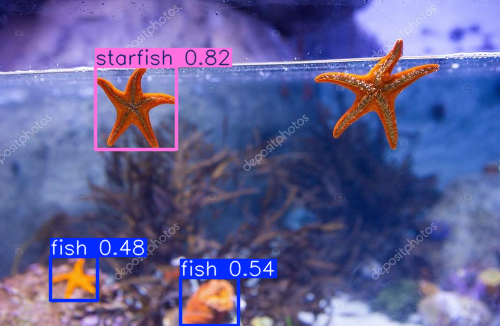

In [ ]:
# Import necessary libraries
import os
from ultralytics import YOLO

# Load the trained model
model = YOLO('/content/Exam/content/runs/detect/train/weights/last.pt')

# Define the path to your test image
image_path = '/content/starfish2.png'

# Run inference on the image
results = model.predict(source=image_path)

# Display the results
for result in results:
    result.show()


image 1/1 /content/shark.jpg: 384x640 1 shark, 140.1ms
Speed: 4.9ms preprocess, 140.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


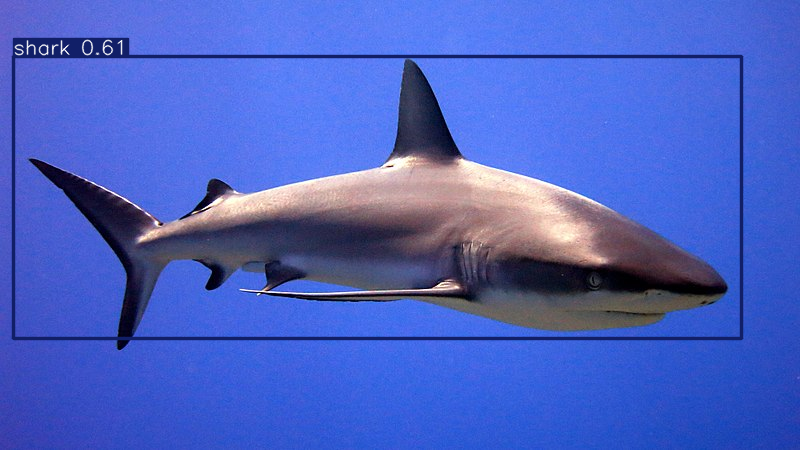

In [ ]:
# Import necessary libraries
import os
from ultralytics import YOLO

# Load the trained model
model = YOLO('/content/Exam/content/runs/detect/train/weights/last.pt')

# Define the path to your test image
image_path = '/content/shark.jpg'

# Run inference on the image
results = model.predict(source=image_path)

# Display the results
for result in results:
    result.show()